# <img style="float: left; padding-right: 10px; width: 45px" src="https://raw.githubusercontent.com/Harvard-IACS/2018-CS109A/master/content/styles/iacs.png"> <i>Eureka?</i> Identifying and Locating Objects on Ancient Greek Vases

##  Final Project for CS209B Advanced Topics in Data Science


**Project Authors**: Abdulla Saif, Mark Conmy, Ibrahim Ouf, Lucas Kitzmüller<br/>

**May 10, 2021**<br/>

<i><a href="https://en.wikipedia.org/wiki/Eureka_(word)">Eureka (Ancient Greek: εὕρηκα)</a> is an interjection used to celebrate a discovery or invention.</i> 

<hr style="height:2pt">

---



In [1]:
# Formatting
import requests
from IPython.core.display import HTML, display
styles = requests.get("https://raw.githubusercontent.com/Harvard-IACS/2018-CS109A/master/content/styles/cs109.css").text
HTML(styles)

<a id="contents"></a>

## Outline 

- [**1 Introduction**](#part1)
    - [1.1 Research Question](#part1-1)
    - [1.2 Summary of Findings](#part1-2)
    - [1.3 Supporting Notebooks and Manually Labeled Data](#part1-3)
    - [1.4 Data Source and Scraping](#part1-4)
    - [1.5 Import libraries](#part1-5)


- [**2 Exploratory Data Analysis**](#part2)
    - [2,1 Distribution of Vase Characteristics](#part2-1)
    - [2,2 Word Clouds of Labels](#part2-2)


- [**3 Creating a High-Quality Dataset**](#part3)
    - [3.1 Labeling](#part3-1)
    - [3.2 Cropping](#part3-2)


- [**4 Weakly Supervised Objected Detection and Classification**](#part4)
    - [4.1 Overview](#part4-1)
    - [4.2 Training and Testing Data](#part4-2)
    - [4.3 The Models](#part4-3)
    - [4.4 Augmentation](#part4-4)
    - [4.5 Examining Performance](#part4-5)
    - [4.6 Visual Inspection: Single Objects](#part4-6)
    - [4.7 Visual Inspection: Multiple Objects](#part4-7)
    - [4.8 Strengths and Weaknesses](#part4-8)
    - [4.9 Future Work](#part4-9)
 
  
- [**5 Introspective Variational AutoEncoder (IntroVAE)**](#part5)
    - [5.1 Motivation](#part5-1)
    - [5.2 Custom Losses](#part5-2)
    - [5.3 Custom Classes](#part5-3)
    - [5.4 Encoder](#part5-4)
    - [5.5 Generator](#part5-5)
    - [5.6 Loading Data](#part5-6)
    - [5.7 Optimizers and Fitting Model](#part5-7)
    - [5.8 Results](#part5-8)
    - [5.9 Comparison with Baseline Model](#part5-9)
    - [5.10 Summary and Future Work](#part5-10)
  

<a id="part1"></a>

# 1. Introduction

[Return to contents](#contents)
<a id="part1-1"></a>
### 1.1 Research Question 
[Return to contents](#contents)

There are massive quantities of images of Greek vases available to researchers. However, the **value of these databases remains limited if researchers have no practical way of searching and sorting these images.** For example, if a classicist who is interested in the representations of Dionysos or Herakles does not have an efficient method of compiling vases with images depicting these objects, they would miss out on a research opportunity. **Currently, labeling these images is a time-intensive manual process, and as a result, many images do not have labels or labels that provide insufficient details needed for more complex analyses.** 

**Developing machine learning models that detect whether and where objects of interest (e.g., Dionysos or Herakles) are depicted on a vase is a complex problem.** Greek vase painting is a uniform field with consistent representations of the objects. However, the **vases, and more importantly, the available images of the vases vary considerably** in terms of perspective, level of zoom, brightness, image dimensions, etc. In addition, computer vision to date has mostly focused on real-world images such as ImageNet. Therefore, learnings may not transfer perfectly to Greek vase paintings in which objects are shown in two dimensions using incisions (black figure vases) or lines (red figure vases).  

The original problem description is available [here](https://drive.google.com/drive/folders/1e9sQ9Q56F47q1n5AOlZktCDJnGe-FUtZ).

<a id="part1-2"></a>
### 1.2 Summary of Findings
[Return to contents](#contents)

We first **scraped the images and metadata from all collections in the [Arms and Armor database](http://armsandarmor.orphe.us/about).** This dataset includes 165,219 images from 66,649 vases. Based on an exploratory analysis of the existing labels, we **decided to focus on four objects: Dionysos, Herakles, Athena, and Hermes.** Given the low consistency and quality of images in the database, we then manually selected a subset of **consistent** images for training and testing. This process involved three steps: (i) **manually removing low quality images** (e.g., images that just show sketches), (ii) **manually creating four labels indicating whether the image depicts objects of interest,** and (iii) **applying a “smart-cropper” based on the Open Computer Vision package to standardize the paintings** and obtain as consistent a depiction as possible. The final dataset we used for training includes **2424 images in total** of which 1881 images depict at least one of the four objects.

We then **use the image labels (i.e. weakly supervised learning) to create a model that detects whether and where any of the objects are depicted on a vase.** Because of our limited number of training images, we rely on **transfer learning** — in particular using the Inception network as our backbone feature detector. Our architecture is based on the concept of utilizing **global average pooling (GAP)** for object detection, as described by [Zhou et al (2016)](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Zhou_Learning_Deep_Features_CVPR_2016_paper.pdf). **The models perform well in detecting whether objects are located on the image.** The F-1 scores of the predictions of our preferred model on the test data range from 0.38 (Hermes) to 0.8 (Dionysos). **The models perform less well in localizing objects on the images.** For tagging purposes, perhaps it is unnecessary to properly localize the objects, but doing so assists humans in confirming the model’s answers. The use of heatmaps could prove sufficient to assist in automatically labelling archives, but masks and bounding boxes rely on subjective cut-offs. **The model’s greatest strength is its sparse requirements for training, requiring to just know whether an object is somewhere on the image rather than where. This suits available data within the archives.**

We also **test using unsupervised learning**. In particular, we create **an introspective variational autoencoder (IntroVAE)** model as described by [Huang et al. 2019](https://arxiv.org/pdf/1807.06358.pdf). The motivation is that **if the autoencoder reconstructs images at high quality, we can apply a clustering algorithm to the latent space to detect emergent categories.** If the event classes/clusters align with meaningful interpretations (e.g., does the image show Dionysos?), then we could also generate vectors from that region in the latent space to create more datapoints for training. Unfortunately, **since the reconstructions are of poor quality, this approach did not work.** Tuning hyperparameters and expanding the dataset could still produce better results but both training the model and manually labelling images proved too time-intensive.

<hr style="height:2pt">

<a id="part1-3"></a>
### 1.3 Supporting Notebooks and Manually Labeled Data
[Return to contents](#contents)

This notebook provides a summary of the completed work. Additional notebooks with the code for web scraping, additional EDA, and modelling are available [here](https://hu-my.sharepoint.com/:f:/g/personal/abdullasaif_hks_harvard_edu/Erv_rrZQsyNCkcgpDB8MnKUB9FLC9JFGxm60b37E645PFg?e=igHeDt) on OneDrive. Apart from the manual labeling of images, all results presented in this notebook can be reproduced by running the notebooks in sequential order. The raw images scraped from the Arms and Armor database as well as manually labelled and cropped images data are saved in the same folder. Throughout the report we provide links to the relevant supporting notebooks and data for reference.

<a id="part1-4"></a>
### 1.4 Data Source and Scraping
[Return to contents](#contents)

We scraped the images and metadata from all collections from the [Arms and Armor database](http://armsandarmor.orphe.us/about): the Beazley Archive, the British Museum, the Harvard Art Museums. We used the code shared by the teaching staff of the course but made some adjustments. For example, we downloaded the images in batches to make the process more robust to connectivity disruptions. The scraping code can be found [here](https://hu-my.sharepoint.com/:u:/g/personal/abdullasaif_hks_harvard_edu/EeFsjTrD321Ityx2Pl3MLS8BDkhYoO3qiB_D4qILKiSokg?e=EzN5Ta).

The scraped data set includes 165,219 images from 66,649 vases. The number of vases is lower than the reported 115,655 items on the Arms and Armor website as many links were broken. The scraped data, organized in batches, is also available on [OneDrive](https://hu-my.sharepoint.com/:f:/g/personal/abdullasaif_hks_harvard_edu/Erv_rrZQsyNCkcgpDB8MnKUB9FLC9JFGxm60b37E645PFg?e=igHeDt),

<a id="part1-5"></a>
### 1.5 Import libraries
[Return to contents](#contents)

In [2]:
# Import libraries

### Common to all
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import PIL
import pickle
import tensorflow as tf

### EDA
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords 
from nltk.tokenize import RegexpTokenizer

### Cropping
from skimage.color import rgb2gray, rgb2hsv, hsv2rgb
from skimage.io import imread, imshow
from scipy import ndimage
import cv2 as cv
from skimage.transform import resize

### Weakly Supervised Learning
import os
gpus = tf.config.experimental.list_physical_devices(device_type='GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint 
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Lambda, GlobalAveragePooling2D, Dense, Conv2D, Dropout 
from tensorflow.keras.applications import InceptionV3, ResNet50, MobileNetV2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from PIL import ImageFont, ImageDraw, Image
from skimage.transform import resize
from sklearn.metrics import f1_score, confusion_matrix, accuracy_score, recall_score, precision_score, plot_confusion_matrix
from matplotlib.ticker import MaxNLocator

# IntroVAE
import tensorflow.keras, tensorflow.keras.backend as K
import requests
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (Conv2D, Flatten, Dense, Dropout, MaxPooling2D,Input, 
                                     Flatten, Reshape, LeakyReLU, Add, Conv2DTranspose, BatchNormalization)
from tensorflow.keras.layers.experimental.preprocessing import (RandomFlip, 
                                                                RandomRotation, 
                                                                RandomTranslation,
                                                                RandomZoom)
from tensorflow.keras.losses import MSE as mean_squared_error
import os, sys, time
from collections import OrderedDict
import losses
import zipfile
import cv2

<a id="part2"></a>

# 2. Exploratory Data Analysis


[Return to contents](#contents)

### Motivation for EDA

We had two primary objectives for the exploratory data analysis of the images metadata. First, **we wanted to understand how the vases in the dataset vary across different chracteristics.** This analysis informed some of our decisions in creating a high quality dataset described as in section 3 (e.g., focusing on Amphoe-type vases). Second, based on the `Decoration` label, **we wanted to identify canonical and ubiquitous objects in the paintings that we could train a model to detect.**

### Loading data

In [3]:
### Load batches
df1 = pd.read_csv('./Source Data/Image Metadata/batch_1_processed.csv')
df2 = pd.read_csv('./Source Data/Image Metadata/batch_2_processed.csv')
df3 = pd.read_csv('./Source Data/Image Metadata/batch_3_processed.csv')
df4 = pd.read_csv('./Source Data/Image Metadata/batch_4_processed.csv')
df5 = pd.read_csv('./Source Data/Image Metadata/batch_5_processed.csv')
df6 = pd.read_csv('./Source Data/Image Metadata/batch_6_processed.csv')
df7 = pd.read_csv('./Source Data/Image Metadata/batch_7_processed.csv')
df8 = pd.read_csv('./Source Data/Image Metadata/batch_8_processed.csv')
df9 = pd.read_csv('./Source Data/Image Metadata/batch_9_processed.csv')
df10 = pd.read_csv('./Source Data/Image Metadata/batch_10_processed.csv')
df11 = pd.read_csv('./Source Data/Image Metadata/batch_11_processed.csv')
df12 = pd.read_csv('./Source Data/Image Metadata/batch_12_processed.csv')

In [4]:
# Useful columns
cols = ['id','Vase Number', 'Fabric', 'Technique', 'Shape Name', 'Date', 'Decoration','Provenance', 'Color', 'Attributed To']

In [5]:
# Concatenating decoration column
df_all = pd.concat([df1[cols],
                    df2[cols],
                    df3[cols],
                    df4[cols],
                    df5[cols],
                    df6[cols],
                    df7[cols],
                    df8[cols],
                    df9[cols],
                    df10[cols],
                    df11[cols],
                    df12[cols]])

# Taking only unique vases
df = df_all.groupby('Vase Number').first().copy()

In [6]:
print(f"Number of images: {df_all.shape[0]}")
print(f"Number of vases: {df.shape[0]}")

Number of images: 165219
Number of vases: 66649


<a id="part2-1"></a>

## 2.1 Distribution of Vase Characteristics

[Return to contents](#contents)

In [7]:
# Number of unique values
for col in cols:
    n = len(pd.unique(df_all[col]))
    print(f"{col}: {n}")

id: 66651
Vase Number: 66650
Fabric: 169
Technique: 51
Shape Name: 415
Date: 39
Decoration: 25359
Provenance: 701
Color: 11
Attributed To: 5286


In [8]:
# Helper function
num_obs = df.shape[0]
def plot_top_k(data, col, k):
    indices = list(df[col].value_counts().index[0:k]) + ['Other']
    values = list(df[col].value_counts().values[0:k]) + [sum(df[col].value_counts().values[k:])]
    return np.array(indices), np.array(values)

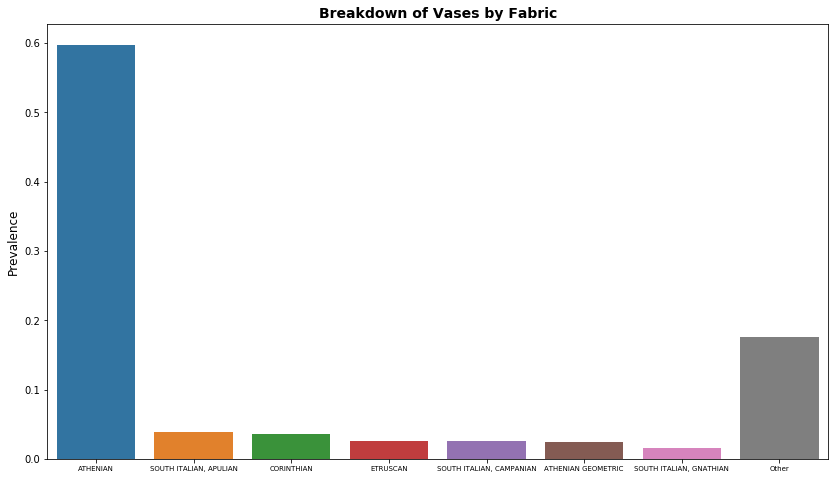

In [9]:
# Fabric
plt.figure(figsize=(14, 8))
sns.barplot(x = plot_top_k(df, 'Fabric', 7)[0], y = plot_top_k(df, 'Fabric', 7)[1]/num_obs)
plt.ylabel('Prevalence', size = 12)
plt.title('Breakdown of Vases by Fabric', size = 14, weight = 'bold')
plt.tick_params(labelsize = 7, axis = 'x')
plt.show()

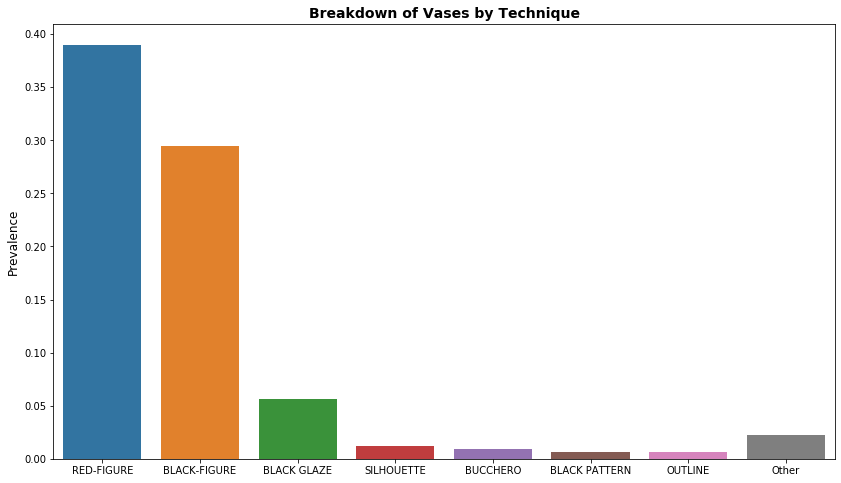

In [10]:
# Technique
plt.figure(figsize=(14, 8))
sns.barplot(x = plot_top_k(df, 'Technique', 7)[0], y = plot_top_k(df, 'Technique', 7)[1]/num_obs)
plt.title('Breakdown of Vases by Technique', size = 14, weight = 'bold')
plt.ylabel('Prevalence', size = 12)
plt.show()

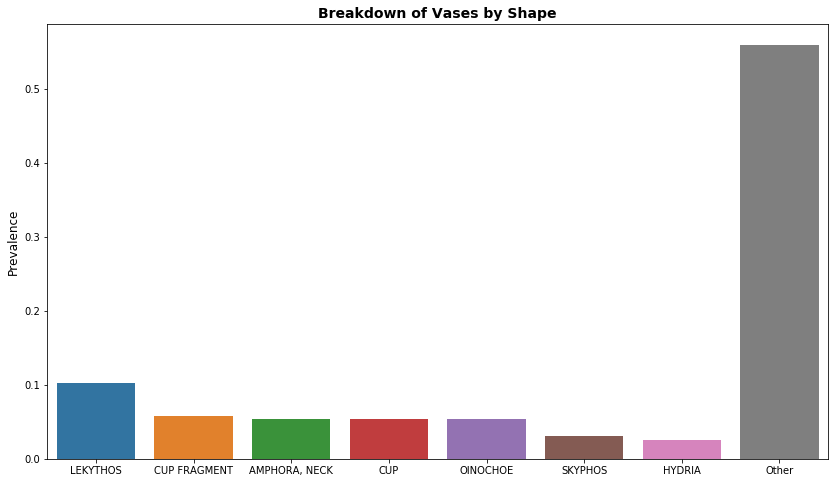

In [11]:
# Shape
plt.figure(figsize=(14, 8))
sns.barplot(x = plot_top_k(df, 'Shape Name', 7)[0], y = plot_top_k(df, 'Shape Name', 7)[1]/num_obs)
plt.title('Breakdown of Vases by Shape', size = 14, weight = 'bold')
plt.ylabel('Prevalence', size = 12)
plt.show()

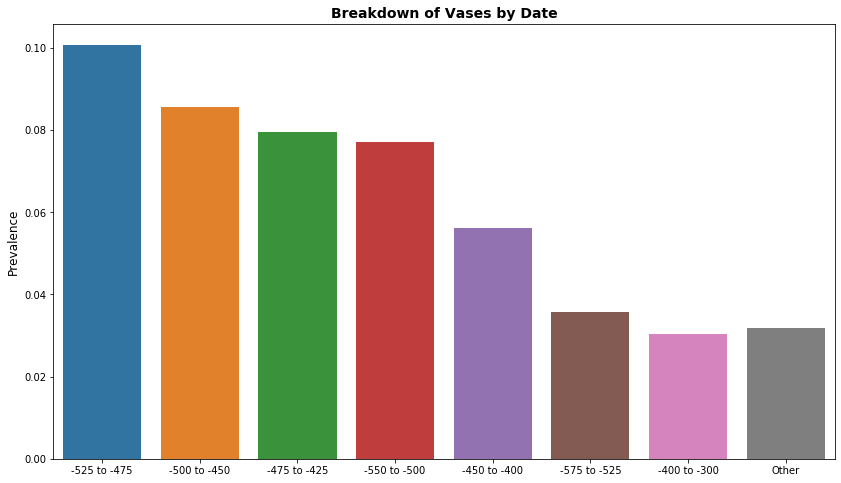

In [12]:
# Date
plt.figure(figsize=(14, 8))
sns.barplot(x = plot_top_k(df, 'Date', 7)[0], y = plot_top_k(df, 'Date', 7)[1]/num_obs)
plt.title('Breakdown of Vases by Date', size = 14, weight = 'bold')
plt.ylabel('Prevalence', size = 12)
plt.show()

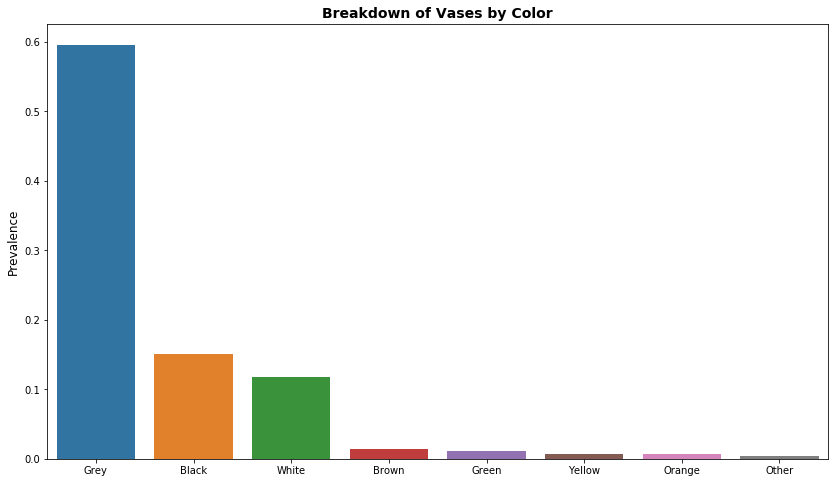

In [13]:
# Color
plt.figure(figsize=(14, 8))
sns.barplot(x = plot_top_k(df, 'Color', 7)[0], y = plot_top_k(df, 'Color', 7)[1]/num_obs)
plt.title('Breakdown of Vases by Color', size = 14, weight = 'bold')
plt.ylabel('Prevalence', size = 12)
plt.show()

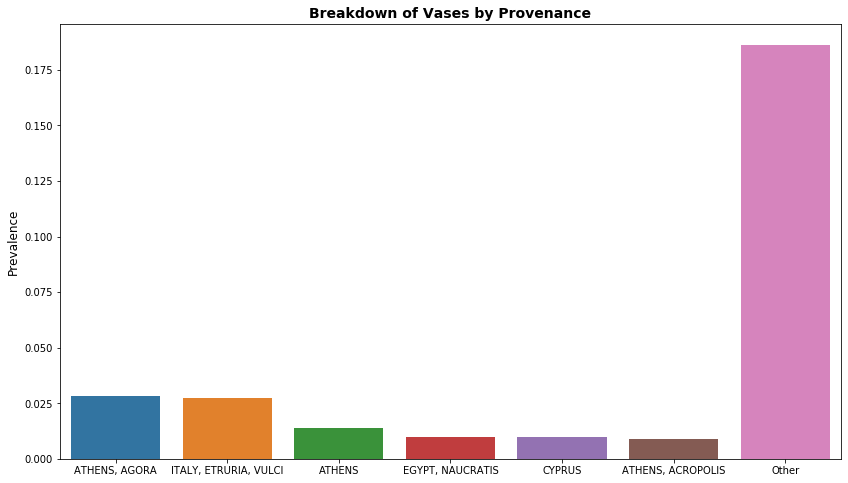

In [14]:
# Provenance
plt.figure(figsize=(14, 8))
sns.barplot(x = plot_top_k(df, 'Provenance', 6)[0], y = plot_top_k(df, 'Provenance', 6)[1]/num_obs)
plt.title('Breakdown of Vases by Provenance', size = 14, weight = 'bold')
plt.ylabel('Prevalence', size = 12)
plt.show()

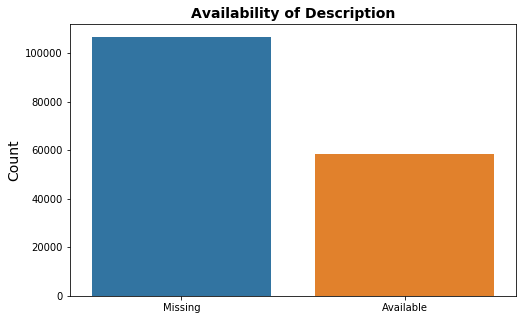

In [15]:
# Missingness of descriptions
plt.figure(figsize=(8, 5))
sns.barplot(x = ['Missing', 'Available'], y = df_all['Decoration'].isna().value_counts())
plt.title('Availability of Description', size = 14, weight = 'bold')
plt.ylabel('Count', size = 14)
plt.show()

### Findings from Distribution Plots

This basic exploratory analysis of each vase’s metadata showed that **6 out of ten vases are Athenian,** by far the biggest fabric category. **40% of paintings use the red-figure technique and 30% the black-figure technique.** **Vases are very heterogeneous in terms of shape,** with the most common shape being Lekythos (10%). Half of the vases date from –525 to –425 BC. Most vases are labeled as gray. Vases’ origins are highly diverse, at least based on the uncleaned provenance string data. An important finding is also that, **‘decoration’, the primary label of the vase paintings, is missing for two-thirds of all images in our dataset.**

<a id="part2-2"></a>

## 2.2 Word Clouds of Labels

[Return to contents](#contents)

To **identify canonical and well-presented objects in the paintings that we could train a model to detect,** we tokenized the ‘decoration’ label and frequency of each word (see unigram word cloud).

In [16]:
# Tokenizing 
tokenizer = RegexpTokenizer(r"\w+") # Remove punctuation
tokens = [tokenizer.tokenize(descr) for descr in list(df.loc[df['Decoration'].notna(), 'Decoration'].values)] # Tokenize not na
tokens = [item for sublist in tokens for item in sublist] # Make flat
tokens = [token.lower() for token in tokens if token.lower() not in stopwords.words('english')] # Remove stopwords
tokens = [token for token in tokens if len(token) > 1] # Remove isolated letters

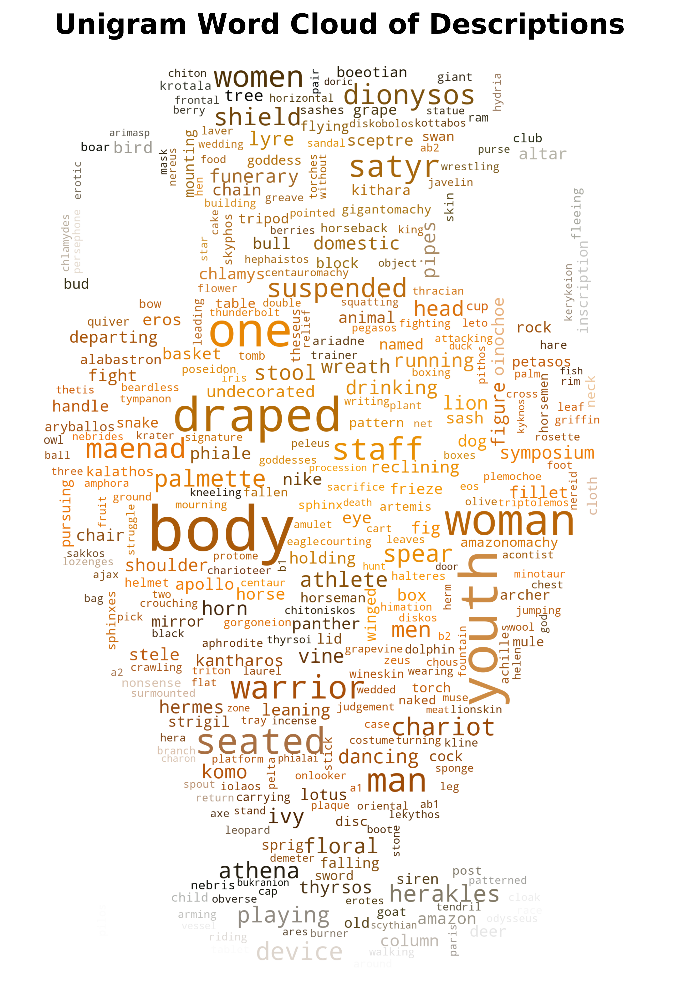

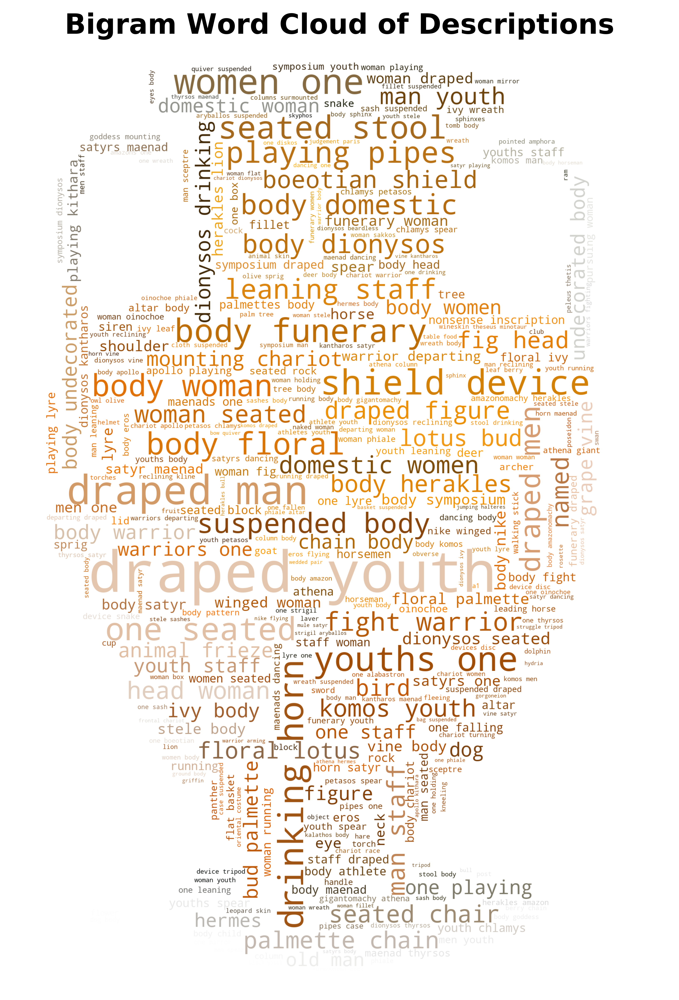

In [17]:
# Background/color
mask = np.array(Image.open("greek_vase.jpg"))
image_colors = ImageColorGenerator(mask)

# Unigram word cloud
wordcloud = WordCloud(background_color="white", max_words=350, mask = mask, collocations=False).generate(' '.join(tokens))
plt.figure(figsize=(10, 10), dpi = 600)
plt.imshow(wordcloud.recolor(color_func=image_colors), interpolation='bilinear')
plt.title('Unigram Word Cloud of Descriptions', size = 16, weight = 'bold')
plt.axis("off")
plt.show()

# Bigram word cloud
wordcloud = WordCloud(background_color="white", max_words=350, mask = mask, collocations=True).generate(' '.join(tokens))
plt.figure(figsize=(10, 10), dpi = 600)
plt.imshow(wordcloud.recolor(color_func=image_colors), interpolation='bilinear')
plt.title('Bigram Word Cloud of Descriptions', size = 16, weight = 'bold')
plt.axis("off")
plt.show()

### Findings from Word Clouds

**Some of the most frequent words describe scenes rather than objects** (e.g., “seated”) or **are too generic to yield a meaningful classification (e.g., “body”).**

Based on these considerations, **we decided to focus on the following four objects in our project:** 

1. **<a href="https://www.theoi.com/Olympios/Dionysos.html">Dionysos</a>**, the Olympian god of wine 
2. **<a href="https://en.wikipedia.org/wiki/Heracles">Heracles</a>**, a Greek hero and the son of Zeus and Alcmene.
3. **[Athena](https://greekgodsandgoddesses.net/goddesses/athena/)**, the goddess of wisdom and war
4. **[Hermes](https://www.greekmythology.com/Olympians/Hermes/hermes.html)**, the messenger of the gods

<a id="part3"></a>

# 3. Creating a High-Quality Dataset


[Return to contents](#contents)


<a id="part3-1"></a>

## 3.1 Manual Labeling and Basic Image Quality Screening

[Return to contents](#contents)

### Motivation

Unfortunately, **`decoration`, the primary label of the vase paintings, is missing for two-thirds** of all images. In addition, during EDA, we **noticed that the labels are inaccurate:** for example, we found many images showing Dionysos with his typical attributes, but the decoration label did not include him. We also found some labels that do include Dionysos but the image does not.  This contamination can prevent any model from effectively detecting Dionysos and his key features.

Further, **the vase images vary considerably.** For example, some images show only sketches, are zoomed in on a particular element, are taken from a high angle, or are too dark to recognize any objects. This lack of uniformity can hinder effective training, as models might end up focusing on backgrounds or other elements within the images rather than the actual painting.

### Process

We therefore decided to **manually screen images for quality and create labels indicating whether they depict the objects of interest.** To ensure the final sample includes sufficiently many images depicting objects of interest, we first tokenized the `decoration` label and selected the images that, at least according to the original label, included one or more of the objects of interest. We then went manually through these pictures and checked that (a) the painting on the vase is clearly visible in the image and (b) added a label for each of the four objects of interest (Athena, Dionysos, Herakles, and Hermes). We followed the same process for some of the images that either had no `decoration` label or for which the `decoration` label did not mention any of the four objects to construct a test set.

The **final labeled training dataset includes 2424 total images.** 1881 images depicting at least one object of interest, and 543 that do not. Within the 1881 labeled images, there are 590 Athena, 758 Dionysos, 686 Herakles, and 231 Hermes. Some images show multiple objects of interest. **The test set has 182 pictures** with 27 observations that contain Athena, 55 Dionysos, 32 Herakles, 17 Hermes, and 74 contain none of the objects.

The final dataset is available [here](https://hu-my.sharepoint.com/:f:/g/personal/abdullasaif_hks_harvard_edu/Esxj8BehxbdKtzchcqCkxb8BPgVro5wcmGawy4FlVkE-5A?e=mWRms0).

We explore this data briefly below.

In [18]:
### Loading metadata

# Useful columns
cols = ['id','Vase Number', 'Fabric', 'Technique', 'Shape Name', 'Date', 'Decoration','Provenance', 'Color', 'Attributed To',
        'batch', 'num']

# Adding batch column
df1.loc[:, 'batch'] = 1
df2.loc[:, 'batch'] = 2
df3.loc[:, 'batch'] = 3
df4.loc[:, 'batch'] = 4
df5.loc[:, 'batch'] = 5
df6.loc[:, 'batch'] = 6
df7.loc[:, 'batch'] = 7
df8.loc[:, 'batch'] = 8
df9.loc[:, 'batch'] = 9
df10.loc[:, 'batch'] = 10
df11.loc[:, 'batch'] = 11
df12.loc[:, 'batch'] = 12

df1.loc[:, 'num'] = df1.index
df2.loc[:, 'num'] = df2.index
df3.loc[:, 'num'] = df3.index
df4.loc[:, 'num'] = df4.index
df5.loc[:, 'num'] = df5.index
df6.loc[:, 'num'] = df6.index
df7.loc[:, 'num'] = df7.index
df8.loc[:, 'num'] = df8.index
df9.loc[:, 'num'] = df9.index
df10.loc[:, 'num'] = df10.index
df11.loc[:, 'num'] = df11.index
df12.loc[:, 'num'] = df12.index

# Concatenating decoration column
df_all = pd.concat([df1[cols],
                    df2[cols],
                    df3[cols],
                    df4[cols],
                    df5[cols],
                    df6[cols],
                    df7[cols],
                    df8[cols],
                    df9[cols],
                    df10[cols],
                    df11[cols],
                    df12[cols]])

In [19]:
# Extract files
batch = glob.glob("./Image Subsets/COLLECTED/*\\*.jpg")
nulls = glob.glob("./Image Subsets/NULL_V4/*/*.jpg")
pre = []
for im in batch:
    pre.append(np.asarray(PIL.Image.open(im)))

# Filter required images
dict_names = [(int(x.split('\\')[-2].split()[-1]), int(x.split('\\')[-1][:-4])) for x in batch]
dict_names = pd.DataFrame(dict_names)
dict_names.columns = ['batch', 'num']
df_filter = pd.merge(dict_names, df_all, on = ['batch', 'num'])

### Overview of Vase Types
**The gallery below shows all available types.** The purpose of the smart cropper developed further below is to extract the paintings from a large variety of vase types. This is clearly a challenging task.

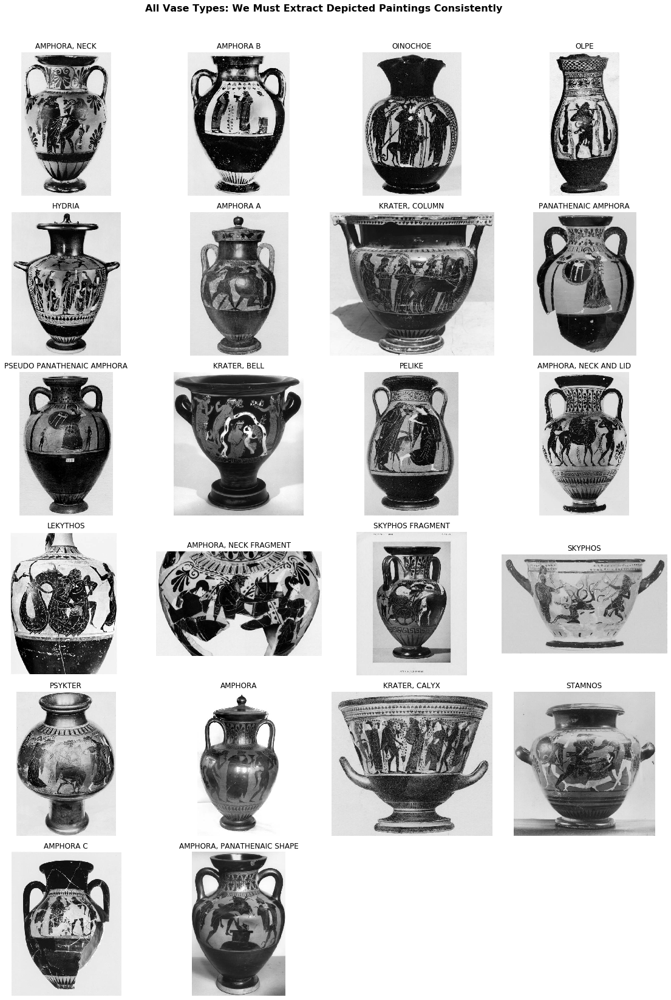

In [20]:
# Showing all vase types
fig, axes = plt.subplots(6, 4, figsize = (16, 24))
axes = axes.flatten()
for i, vase_type in enumerate(df_filter['Shape Name'].unique()):
    if vase_type == 'OINOCHOE':
        select = df_filter.loc[df_filter['Shape Name']==vase_type, :].index[5]
    elif vase_type in ['AMPHORA C', 'LEKYTHOS', 'PSEUDO PANATHENAIC AMPHORA']:
        select = df_filter.loc[df_filter['Shape Name']==vase_type, :].index[1]
    else:
        select = df_filter.loc[df_filter['Shape Name']==vase_type, :].index[0]
    axes[i].imshow(pre[select], cmap = plt.cm.gray)
    axes[i].set_title(f'{vase_type}')
    axes[i].axis('off')
axes[22].remove()
axes[23].remove()
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.suptitle('All Vase Types: We Must Extract Depicted Paintings Consistently', size = 16, weight = 'bold')
plt.show()

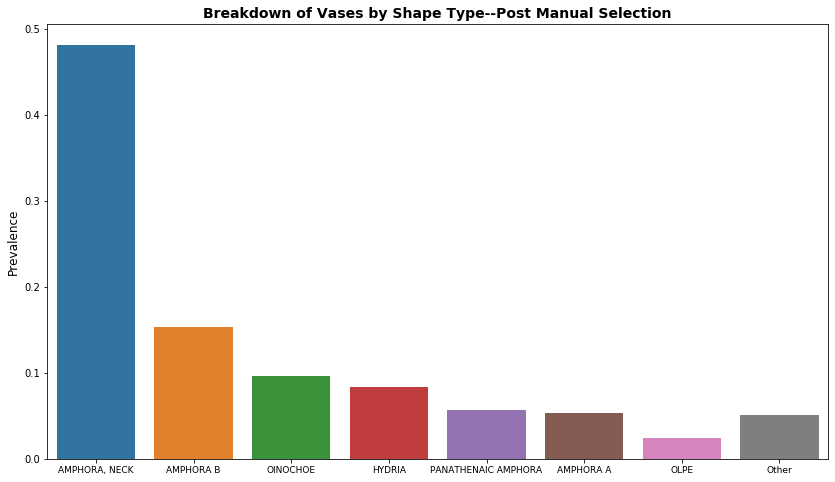

In [21]:
# Showing vase type by prevalence
def plot_top_k(data, col, k):
    indices = list(data[col].value_counts().index[0:k]) + ['Other']
    values = list(data[col].value_counts().values[0:k]) + [sum(data[col].value_counts().values[k:])]
    return np.array(indices), np.array(values)
num_obs = df_filter.shape[0]
plt.figure(figsize=(14, 8))
sns.barplot(x = plot_top_k(df_filter, 'Shape Name', 7)[0], y = plot_top_k(df_filter, 'Shape Name', 7)[1]/num_obs)
plt.ylabel('Prevalence', size = 12)
plt.title('Breakdown of Vases by Shape Type--Post Manual Selection', size = 14, weight = 'bold')
plt.tick_params(labelsize = 9, axis = 'x')
plt.show()

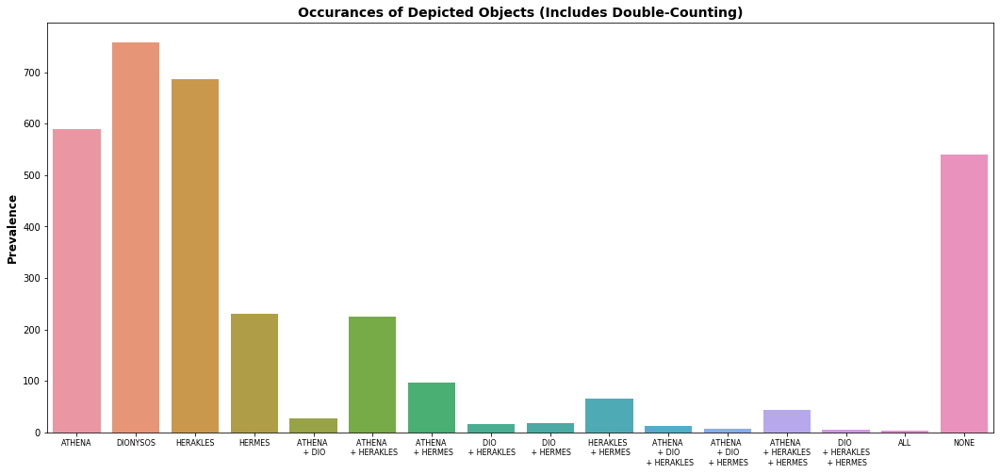

In [22]:
### Checking co-occurances

# Load
df_counts = pd.read_csv('./Image Subsets/COLLECTED/pictures_classes.csv')
df_counts = df_counts[['ATHENA', 'DIONYSOS', 'HERAKLES', 'HERMES']]

# Add columns to count co-occurances
df_counts.loc[:, 'ATHENA \n + DIO'] = df_counts.apply(lambda x: 1 if x.ATHENA + x.DIONYSOS > 1 else 0, axis = 1)
df_counts.loc[:, 'ATHENA \n + HERAKLES'] = df_counts.apply(lambda x: 1 if x.ATHENA + x.HERAKLES > 1 else 0, axis = 1)
df_counts.loc[:, 'ATHENA \n + HERMES'] = df_counts.apply(lambda x: 1 if x.ATHENA + x.HERMES > 1 else 0, axis = 1)
df_counts.loc[:, 'DIO \n + HERAKLES'] = df_counts.apply(lambda x: 1 if x.DIONYSOS + x.HERAKLES  > 1 else 0, axis = 1)
df_counts.loc[:, 'DIO \n + HERMES'] = df_counts.apply(lambda x: 1 if x.DIONYSOS + x.HERMES > 1 else 0, axis = 1)
df_counts.loc[:, 'HERAKLES \n + HERMES'] = df_counts.apply(lambda x: 1 if x.HERAKLES + x.HERMES > 1 else 0, axis = 1)

df_counts.loc[:, 'ATHENA \n + DIO \n + HERAKLES'] = df_counts.apply(lambda x: 1 if x.ATHENA + x.DIONYSOS + x.HERAKLES > 2 else 0, axis = 1)
df_counts.loc[:, 'ATHENA \n + DIO \n + HERMES'] = df_counts.apply(lambda x: 1 if x.ATHENA + x.DIONYSOS + x.HERMES > 2 else 0, axis = 1)
df_counts.loc[:, 'ATHENA \n + HERAKLES \n + HERMES'] = df_counts.apply(lambda x: 1 if x.ATHENA + x.HERAKLES + x.HERMES > 2 else 0, axis = 1)
df_counts.loc[:, 'DIO \n + HERAKLES \n + HERMES'] = df_counts.apply(lambda x: 1 if x.DIONYSOS + x.HERAKLES + x.HERMES > 2 else 0, axis = 1)

df_counts.loc[:, 'ALL'] = df_counts.apply(lambda x: 1 if x.ATHENA + x.DIONYSOS + x.HERAKLES + x.HERMES > 3 else 0, axis = 1)

# Plot
plt.figure(figsize=(18, 8))
sns.barplot(list(df_counts.sum(axis=0).index) + ['NONE'], list(df_counts.sum(axis=0)) + [len(nulls)])
plt.ylabel('Prevalence', size = 12, weight = 'bold')
plt.title('Occurences of Depicted Objects (Includes Double-Counting)', size = 14, weight = 'bold')
plt.tick_params(labelsize = 8, axis = 'x')
plt.show()

**All four objects of interest** (Athena, Dionysos, Herakles, Hermes) **generally occur more often in isolation than with other objects of interest.** We note, however, that **especially Athena tends co-occur a lot with Herakles.** This is unsurprising as she helped Herakles during his 12 labors [(source)](https://www.thoughtco.com/the-goddess-athena-helps-hercules-117193
). **Athena and Hermes also often appear in the same painting, as do Herakles and Hermes.**

<a id="part3-2"></a>

## 3.2 Smart-Cropping

[Return to contents](#contents)



### Overview

**Despite the basic quality screening in step 3.1, one of the dataset’s greatest limitations remains the mixture of zoomed out images depicting the entire vases—i.e. the painting and vase body—and those depicting just the scenes/paintings. Furthermore, the vases differ in their dimensions, so the paintings also differ in their dimensions. Thus, we implemented a “smart-cropper” to standardize the paintings and obtain as consistent a depiction as possible.**

We used the Open Computer Vision package to create our smart cropper. **By thresholding the image by color, we are able to obtain a mask of the vase if the image is zoomed out, allowing us to separate foreground from background. Then, we utilize edge detection to draw a bounding box around the vase (if not zoomed in). From there, taking advantage of the fact vases of the same type have similar dimensions with their paintings located in comparable positions, we crop out vase-specific portions of the bounded box (manually calibrated for each vase type). To account for the fact some images depict only the painting while others are already sufficiently zoomed in, we take advantage of the fact said images almost always have greater width than height to filter them out. We also utilize the ratio of the areas of the bounding box and whole images to filter out images already sufficiently zoomed in.** The end result is a far cleaner set of consistent (though not completely perfect) images depicting the paintings on the vases.

Below are the manually calibrated parameters to extract out of the bounding-box/region of interest within the vases. The cropping function is shown below. We allow for some exceptions based on a combination of vase type and extracted bounding base. This occurs because some vase types differ in dimensions more than others.

In [23]:
### Helper function and parameters

# Setting cropping parameters by vase type
scale_dict = {
    'AMPHORA' : [0.38, 0.8, 0.1],
    'AMPHORA_A' : [0.25, 0.67, 0.1],
    'AMPHORA_B' : [0.24, 0.75, 0.1],
    'AMPHORA_C' : [0.25, 0.55, 0.15],
    'AMPHORA_NECK_AND_LID' : [0.3, 0.75, 0.1],
    'AMPHORA_NECK' : [0.25, 0.78, 0.1],
    'AMPHORA_PANATHENAIC_SHAPE' : [0.25, 0.55, 0.1], 
    'HYDRIA' : [0.2, 0.78, 0.1],
    'KRATER_BELL' : [0.2, 0.68, 0.13],
    'KRATER_CALYX' : [0.17, 0.63, 0.04], 
    'KRATER_COLUMN' : [0.3, 0.8, 0.1], 
    'LEKYTHOS' : [0.32, 0.75, 0.08],
    'OINOCHOE' : [0.2, 0.9, 0], 
    'OLPE' : [0.23, 0.8, 0.06], 
    'PELIKE' : [0.2, 0.75, 0.08], 
    'PSYKTERE' : [0.25, 0.7, 0.1], 
    'SKYPHOS_FRAGMENT' : [0.3, 0.8, 0], 
    'STAMNOS' : [0.25, 0.8, 0.15],
    'PSEUDO_PANATHENAIC_AMPHORA' : [0.2, 0.6, 0.07],
    'PANATHENAIC_AMPHORA': [0.2, 0.6, 0.07]
}
resize_dim = (400, 600)

# Smart cropper function
def pre_process(input_im, resize_dim, vase_type):
    
    copy_im = input_im.copy()
    
    # Find type
    vase_type = vase_type.replace(", ", "_").replace(' ', "_")
    try:
        vase_scale = scale_dict[vase_type]
    except:
        vase_scale = [0.3, 0.75, 0.08]

    # Find external contours, blur, threshold
    try: # Make black and white if not already so
        gray = cv.cvtColor(input_im, cv.COLOR_BGR2GRAY)
    except:
        gray = input_im
    blur = cv.GaussianBlur(gray, (3,3), 0)
    thresh = cv.threshold(blur, 0, 255, cv.THRESH_BINARY_INV + cv.THRESH_OTSU)[1]

    # Obtain bounding rectangle and extract ROI (this should bound the vase)
    x,y,w,h = cv.boundingRect(thresh)
    ROI = input_im[y:y+h, x:x+w]
    
    # Examine whether ROI is sufficiently large region does not need cropped
    ltw = input_im.shape[1]/input_im.shape[0]
    im_area = input_im.shape[0]*input_im.shape[1]
    ROI_area = ROI.shape[0]*ROI.shape[1]
    
    # Crop
    if (vase_type=='OINOCHOE' and (ROI_area/im_area) > 0.9):
        print('OINOCHOE!')
        y_low = int(input_im.shape[0]*0.25)
        y_high = int(input_im.shape[0]*0.85)
        x_left = int(input_im.shape[1]*0.05)
        x_right = int(input_im.shape[1]*0.95)
        subimage = copy_im[y_low : y_high , x_left : x_right]
    else:
        if ltw < 0.99 or vase_type in ['KRATER_CALYX', 'KRATER_COLUMN', 'STAMNOS']:
            # Crop within the vase
            y_low = int(ROI.shape[0]*vase_scale[0])
            y_high = int(ROI.shape[0]*vase_scale[1])
            x_left = int(x + ROI.shape[1]*vase_scale[2])
            x_right = int(x + w - ROI.shape[1]*vase_scale[2])
            subimage = copy_im[y_low : y_high , x_left : x_right]
        else:
            print('Do not crop!')
            subimage = copy_im

    # Final resize
    result = resize(subimage, resize_dim)
    return result

### Demonstration of Smart-Cropping Process

The vase type is OINOCHOE
Based on vase type OINOCHOE, the box dimensions on the vase are: [0.2, 0.9, 0]


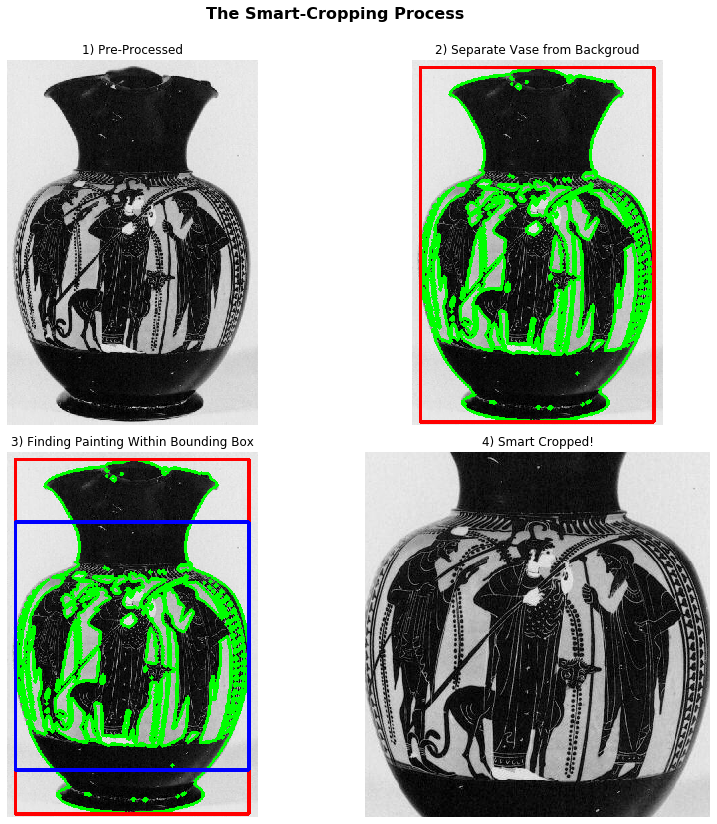

In [25]:
### Demo: Explaining the smart cropper step by step
vase_types = df_filter['Shape Name'].values
fig, axes = plt.subplots(2, 2, figsize = (12, 12))
axes = axes.flatten()

# Select image (e.g. 55, 84)
idx = 55
ex_im = pre[idx].copy()
copy_im = ex_im.copy()

# 1) We display pre-procesed version
axes[0].imshow(pre[idx])
axes[0].axis('off')
axes[0].set_title('1) Pre-Processed')

# Find type
vase_type = vase_types[idx].replace(", ", "_").replace(' ', "_")
print(f'The vase type is {vase_type}')
try:
    vase_scale = scale_dict[vase_type]
except:
    vase_scale = [0.3, 0.75, 0.08]

print(f'Based on vase type {vase_type}, the box dimensions on the vase are: {vase_scale}')

# Find external contours, blur, threshold
try: # Make black and white if not already so
    gray = cv.cvtColor(ex_im, cv.COLOR_BGR2GRAY)
except:
    gray = ex_im
blur = cv.GaussianBlur(gray, (3,3), 0)
thresh = cv.threshold(blur, 0, 255, cv.THRESH_BINARY_INV + cv.THRESH_OTSU)[1]
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
cntrs = cv.drawContours(ex_im, contours, -1, (0,255,0), 3)

# Obtain bounding rectangle and extract ROI (this should bound the vase)
x,y,w,h = cv.boundingRect(thresh)
box = cv.rectangle(ex_im,(x,y),(x+w,y+h),(255,0,0),3)
ROI = ex_im[y:y+h, x:x+w]

# 2) Draw the bounding bax separating vase from background
axes[1].imshow(ex_im)
axes[1].axis('off')
axes[1].set_title('2) Separate Vase from Backgroud')

# Examine whether ROI is sufficiently large region does not need cropped (These arguments are not used in our case)
ltw = ex_im.shape[1]/ex_im.shape[0]
im_area = ex_im.shape[0]*ex_im.shape[1]
ROI_area = ROI.shape[0]*ROI.shape[1]

# Crop: special cases for problematic vase types
if (vase_type=='OINOCHOE' and ((ROI_area/im_area) > 0.9 and (ROI_area/im_area) > 0.98)): # This case will be used
    print('OINOCHOE!')
    y_low = int(ex_im.shape[0]*0.25)
    y_high = int(ex_im.shape[0]*0.85)
    x_left = int(ex_im.shape[1]*0.05)
    x_right = int(ex_im.shape[1]*0.95)
    subimage = copy_im[y_low : y_high , x_left : x_right]
else:
    if ltw < 0.99 or vase_type in ['KRATER_CALYX', 'KRATER_COLUMN', 'STAMNOS']: 
        # Crop within the vase
        y_low = int(ROI.shape[0]*vase_scale[0])
        y_high = int(ROI.shape[0]*vase_scale[1])
        x_left = int(x + ROI.shape[1]*vase_scale[2])
        x_right = int(x + w - ROI.shape[1]*vase_scale[2])
        subimage = copy_im[y_low : y_high , x_left : x_right]
    else:
        print('Do not crop!')
        subimage = copy_im

# 3) Draw ROI
box2 = cv.rectangle(ex_im,(x_left, y_high),(x_right, y_low),(0,0,255),3)      
axes[2].imshow(ex_im)
axes[2].axis('off')
axes[2].set_title('3) Finding Painting Within Bounding Box')
    
# 4) Draw final result
axes[3].imshow(subimage)
axes[3].axis('off')
axes[3].set_title('4) Smart Cropped!')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.suptitle('The Smart-Cropping Process', size = 16, weight = 'bold')
plt.show()

### Apply Smart-Cropper to Training Set

In [26]:
##### Run for processing training set 
# (commented out to speed up the re-run of the notebook by the interested reader)

# # Process images
# processed = []
# for i, im in enumerate(pre):
#     process_im = pre_process(im, (400, 600), vase_types[i])
#     processed.append(process_im)

OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
OINOCHOE!
OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
OINOCHOE!
OINOCHOE!
OINOCHOE!
OINOCHOE!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not cr

In [9]:
# Saving to disk (name linked to its meta-data)
# for i, im in enumerate(processed):
#     try:
#         im = cv.cvtColor(im.astype('float32'), cv.COLOR_BGR2GRAY)
#     except:
#         im = im
#     finally:
#         meta = batch[i].split('\\')
#         batch_num = meta[-2]
#         number = meta[-1][:-4]
#         name = batch_num + "_" + number + ".jpg"
#         path = f'./Cropped3/COLLECTED/{batch_num}/{name}'
#         plt.imsave(path, im, cmap = plt.cm.gray)

### Apply Smart-Cropper to Null and Test Set

In [10]:
##### Run for Null
# pre = []
# for im in nulls:
#     pre.append(np.asarray(PIL.Image.open(im)))
    
# # Filter required images
# dict_names = [(int(x.split('\\')[-2].split()[-1]), int(x.split('\\')[-1][:-4])) for x in nulls]
# dict_names = pd.DataFrame(dict_names)
# dict_names.columns = ['batch', 'num']
# df_filter = pd.merge(dict_names, df_all, on = ['batch', 'num'])

# # Process images
# processed = []
# vase_types = df_filter['Shape Name'].values
# for i, im in enumerate(pre):
#     process_im = pre_process(im, (400, 600), vase_types[i])
#     processed.append(process_im)
    
# # Save to disk
# shapes = df_filter['Shape Name'].values
# for i, im in enumerate(processed):
#     try:
#         im = cv.cvtColor(im.astype('float32'), cv.COLOR_BGR2GRAY)
#     except:
#         im = im
#     meta = nulls[i].split('\\')
#     batch_num = meta[-2]
#     number = meta[-1][:-4]
#     name = batch_num + "_" + number + ".jpg"
#     path = f'./Cropped3/NULL_v4/{batch_num}/{name}'
#     plt.imsave(path, im, cmap = plt.cm.gray)

Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!

In [11]:
### Run for Test set

# # Extract files
# batch = glob.glob("./Image Subsets/COLLECTED_TEST/*\\*.jpg")
# pre = []
# for im in batch:
#     pre.append(np.asarray(PIL.Image.open(im)))

# # Filter required images
# dict_names = [(int(x.split('\\')[-2].split()[-1]), int(x.split('\\')[-1][:-4])) for x in batch]
# dict_names = pd.DataFrame(dict_names)
# dict_names.columns = ['batch', 'num']
# df_filter = pd.merge(dict_names, df_all, on = ['batch', 'num'])

# # Process images
# processed = []
# vase_types = df_filter['Shape Name'].values
# for i, im in enumerate(pre):
#     process_im = pre_process(im, (400, 600), vase_types[i])
#     processed.append(process_im)
    
# # Saving to disk (name linked to its meta-data)
# shapes = df_filter['Shape Name'].values
# for i, im in enumerate(processed):
#     try:
#         im = cv.cvtColor(im.astype('float32'), cv.COLOR_BGR2GRAY)
#     except:
#         im = im
#     finally:
#         meta = batch[i].split('\\')
#         batch_num = meta[-2]
#         number = meta[-1][:-4]
#         name = batch_num + "_" + number + ".jpg"
#         path = f'./Cropped3/COLLECTED_TEST/{batch_num}/{name}'
#         plt.imsave(path, im, cmap = plt.cm.gray)

Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!
Do not crop!



<a id="part4"></a>

# 4. Weakly Supervised Objected Detection and Classification

[Return to contents](#contents)

<a id="part4-1"></a>

## 4.1 Overview

[Return to contents](#contents)  
Using nothing but image-level labels (i.e. **weakly supervised learning**), we create a model that successfully detects whether an object of interest (i.e. Dionysos, Herakles, Athena, Hermes or any combination of them) is depicted on a vase and where. Because of our limited number of training images, we rely on **transfer learning**—in particular using the Inception network as our backbone feature detector. Our architecture is based on the concept of utilizing **global average pooling (GAP)** for object detection, as described by Zhou et al (2016): [Learning Deep Features for Discriminative Localization](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Zhou_Learning_Deep_Features_CVPR_2016_paper.pdf).

The key idea is to **create class activation maps (CAMs) from the feature maps generated by GAP. The CAMs are computed as a weighted average of those feature maps.** The process is shown below, or [here](https://hu-my.sharepoint.com/:i:/r/personal/abdullasaif_hks_harvard_edu/Documents/CS109B_Project/Cams2.PNG?csf=1&web=1&e=4dT2TS) in case this notebook is not viewed on OneDrive (the image is from the paper):

![title](Cams2.PNG)

**We then detect the objects by thresholding the CAMs.** We utilize networks pre-trained on ImageNet as the backbone convolutional model, which is then fed into a GAP layer. We show this successfully overcame our limited and messy dataset. **We note that we are tackling a multi-label rather than multi-class problem.** The objects we seek to detect frequently occur together, presenting an interesting multilabel challenge. 

We relied on the following sources:

1) https://github.com/ray0809/weakly-supervised-object-localization

2) http://emaraic.com/blog/weakly-supervised-detection

3) https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Zhou_Learning_Deep_Features_CVPR_2016_paper.pdf

4) https://github.com/tahaemara/weakly-supervised-detection

In [2]:
#### Global parameters
INPUT_SIZE = 256
CLASS_NUM = 4
EPOCH = 10
BATCH_SIZE = 32
TO_TRAIN = False # Set True to retrain all models
class_dict = ['ATHENA', 'DIONYSOS', 'HERAKLES', 'HERMES']

In [3]:
### Define helper functions

# Convert, process and resize
def process_data(inp_data):
    result = np.array(inp_data)
    result = preprocess_input(result.astype('float32'))
    return np.array([resize(im, (INPUT_SIZE, INPUT_SIZE)) for im in result])

# For resize layers
def Resize(x):
    y = tf.image.resize(x, size=(256,256))
    return y

# Provides CAM and class prediction
def output_CAM_class(model, weights, inp, class_num):
    
    # Preprocess input
    inp = preprocess_input(np.expand_dims(inp, axis=0))
    
    # Predict
    conv_feat, prob = model.predict(inp) # Dimensions 1x256x256x2048 and 1xk classes
    conv_feat = conv_feat[0] # Index first because single image input
    prob = prob[0] # Index first because single image input
    
    # Extract CAM (Class Activation Map)
    weights = weights[:, class_num].reshape(1, 1, -1) # Find weights for predicted class and reshape
    CAM = (conv_feat * weights).sum(axis=2) # Sum weights across activation maps by channel
    CAM = (CAM - CAM.min()) / (CAM.max() - CAM.min()) # Normalize CAM
    return CAM, prob

# Creating bounding box (requires heatmap first)
def bounding_box(rgb_inp, CAM_inp, threshold = 170):
    
    CAM_scaled = np.uint8(CAM_inp*255) # Scale for format
    ret, cam_img = cv2.threshold(CAM_scaled, threshold, 255, cv2.THRESH_BINARY) # Threshold for mask
    contours, hierarchy = cv2.findContours(cam_img, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE) # Find countours
    
    # Draw located inner and outter contours
    for i, contour in enumerate(contours):
        boundRect = cv2.boundingRect(contour)
        cv2.drawContours(rgb_inp, contours, i, (255, 255, 0, 0), 3, 4, hierarchy)
        cv2.rectangle(rgb_inp, (int(boundRect[0]), int(boundRect[1])), \
                      (int(boundRect[0] + boundRect[2]), int(boundRect[1] + boundRect[3])), (255, 0, 0, 0), 2)

    return rgb_inp

# Diplays heatmap, bounding box, segmentation and mask in 2x2 grid image for selected class
def visualize_class(model, weights, inp, class_num, thresh = 180):
    fig, axes = plt.subplots(2, 2, figsize = (10, 10))
    axes = axes.flatten()

    # Drawing heatmap
    heatmap, pred = output_CAM_class(middle_model, weights, img_rgb, class_num)
    axes[0].imshow(img_rgb)
    axes[0].imshow(heatmap, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
    axes[0].axis('off')
    axes[0].set_title(f'Heatmap: {class_dict[class_num]}')

    box = bounding_box(img_rgb, heatmap, thresh)
    axes[1].imshow(box)
    axes[1].axis('off')
    axes[1].set_title(f'Bounding Box--Predict: {class_dict[class_num]}')

    CAM_scaled = np.uint8(heatmap*255) # Scale for format
    ret, cam_img = cv2.threshold(CAM_scaled, thresh, 255, cv2.THRESH_BINARY) # Threshold for mask
    axes[2].imshow(cam_img)
    axes[2].axis('off')
    axes[2].set_title(f'Image Segmentation')

    axes[3].imshow(np.repeat(np.expand_dims(cam_img, axis = 2),3, axis = 2)*img_rgb)
    axes[3].axis('off')
    axes[3].set_title(f'Masked')
    plt.suptitle(f'I Found {class_dict[class_num]}!', size = 16, weight = 'bold')
    fig.tight_layout()
    plt.show()
    
# Draws contours for cam maps
def draw_CAM_countours(CAMs_list, CAMs_idx, img_rgb, thresh = 220):
    # Draw countours
    for j, cam in enumerate(CAMs_list):
        CAM_scaled = np.uint8(cam*255) # Scale for format
        ret, cam_img = cv2.threshold(CAM_scaled, thresh, 255, cv2.THRESH_BINARY) # Threshold for mask
        contours, hierarchy = cv2.findContours(cam_img, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE) # Find countours

        # Draw located inner and outter contours
        for i, contour in enumerate(contours):
            boundRect = cv2.boundingRect(contour)
            cv2.drawContours(img_rgb, contours, i, (255, 255, 0, 0), 3, 4, hierarchy)
            cv2.rectangle(img_rgb, (int(boundRect[0]), int(boundRect[1])), \
                          (int(boundRect[0] + boundRect[2]), int(boundRect[1] + boundRect[3])), (255, 0, 0, 0), 2)
            cv2.putText(img_rgb, f'{class_dict[CAMs_idx[j]]}', (int(boundRect[0]), int(boundRect[1] + boundRect[3])), 
                        cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 220, 127), 2)

# Makes 10 CAMS for images of a given class number
def make_10_CAMS_class(class_num, seed = 109):
    # Process and generate heatmaps
    np.random.seed(seed)
    name = class_dict[class_num]
    images = np.array(data)[np.random.choice(np.where(labs[:, class_num]==1)[0], 10, replace=False)]
    images_rgb = [cv2.resize(cv2.cvtColor(im, cv2.COLOR_BGR2RGB), (INPUT_SIZE, INPUT_SIZE)) for im in images]
    heatmaps = [output_CAM_class(middle_model, weights, im, class_num)[0] for im in images_rgb]

    # Plot
    fig, axes = plt.subplots(2, 5, figsize = (14, 6))
    axes = axes.flatten()
    for i,ax in enumerate(axes):
        ax.imshow(images_rgb[i])
        ax.imshow(heatmaps[i], cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
        ax.axis('off')
    plt.suptitle(f'Examining {name} CAMs for {name} Images to Analyze Feature Importance', size = 14, weight = 'bold')
    fig.tight_layout()
    plt.show()
    
# Performance evaluation
def plot_conf_mat(true, preds, title):
    
    # Find normalized confusion matrix
    conf_mat = confusion_matrix(true, preds)
    conf_mat = confusion_matrix(true, preds)
    conf_mat = (conf_mat.astype('float') /  conf_mat.sum(axis=1)[:, np.newaxis])
    
    # Plot
    fig, ax = plt.subplots(figsize = (10, 8))
    sns.heatmap(conf_mat, annot = True, fmt = '.2f', xticklabels = class_dict, yticklabels = class_dict)
    plt.ylabel('Actual', size = 14, weight = 'bold')
    plt.xlabel('Predicted', size = 14, weight = 'bold')
    plt.title(f'Confusion Matrix for {title}', size = 16, weight = 'bold')
    plt.yticks(va = 'center')
    plt.show()

# Threshold predictions
def thresh_pred(num):
    return 1 if num > 0.5 else 0
thresh_pred = np.vectorize(thresh_pred)

# Class prediction for confusion matrix
def class_pred(num):
    if num.sum() == 0:
        return 2.0
    elif num.sum() == 2:
        return 3.0
    else:
        return float(np.argmax(num))
    
# Returns a list of metrics for inputted model and data
def return_metrics(model, inp_data, labels):
    preds_test = model.predict(inp_data)
    preds_test = thresh_pred(preds_test)
    accu = accuracy_score(labels, preds_test)
    precision = precision_score(labels, preds_test, average = None)
    recall = recall_score(labels, preds_test, average = None)
    f1 = f1_score(labels, preds_test, average = None)
    return accu, precision, recall, f1

<a id="part4-2"></a>

## 4.2 Training and Testing Data

[Return to contents](#contents)

In [4]:
### Pre-processing

## Training data

# Load
data = []
with_lab = glob.glob("./Cropped3/COLLECTED/*/*.jpg")
null = glob.glob("./Cropped3/NULL_v4/*/*.jpg")
for im in with_lab + null:
    data.append(np.asarray(PIL.Image.open(im)))
    
# Resize images and process
train = process_data(data)

# Create labels
labs_df = pd.read_csv('./pictures_classes.csv')
labs_df.loc[:, 'batch'] = labs_df.apply(lambda x: int(x.FILENAMES.split('/')[1].split(' ')[1]), axis = 1)
labs_df.loc[:, 'num'] = labs_df.apply(lambda x: int(x.FILENAMES.split('/')[-1].replace('.jpg', '')), axis = 1)
labs = []
for x in with_lab:
    number = int(x.split('_')[-1].replace('.jpg', ''))
    batch_num = int(x.split('/')[-2].split(" ")[-1])
    val = labs_df.loc[(labs_df['batch']==batch_num) & (labs_df['num']==number),][['ATHENA', 'DIONYSOS', 'HERAKLES', 'HERMES']].values
    labs.append(val)
labs = np.array(labs)[:, 0, :]
labs = np.concatenate([labs, np.zeros((len(null), 4))], axis = 0)

In [5]:
## Testing data

# Load
test = []
test_load = glob.glob("./Cropped3/COLLECTED_TEST/*/*.jpg")
for im in test_load:
    test.append(np.asarray(PIL.Image.open(im)))
    
# Resize images and process
test2 = process_data(test)

# Create labels
test_labs_df = pd.read_excel('./pictures_test_classes.xlsx')
test_labs = []
for x in test_load:
    number = int(x.split('_')[-1].replace('.jpg', ''))
    batch_num = int(x.split('/')[-2].split(" ")[-1])
    val = test_labs_df.loc[(test_labs_df['BATCH']==batch_num) & (test_labs_df['IMAGE']==number),][['ATHENA', 'DIONYSOS', 'HERAKLES', 'HERMES']].values
    test_labs.append(val)
test_labs = np.array(test_labs)
test_labs = test_labs[:, 0, :]

<a id="part4-3"></a>

## 4.3 The Models

[Return to contents](#contents)

**We create 4 models: 3 variations using the Inception network and one using Resnet. By cutting off the topmost layers of these networks, we can append our GAP layer followed by a dense layer for multi-label classification**. One challenge is balancing the pre-trained networks’ ability to detect features based on the ImageNet dataset and adjusting their weights for our own task. By freezing layers, we retain the ability to detect features but risk not adjusting the weights enough for our task. Hence, **we must freeze an appropriate number of upper layers and properly balance low-level feature detection common across all images and macro features representative of our dataset.** Thus, we experiment with 3 models utilizing Inception as the backbone but differing in the number of frozen layers: 20 topmost layers frozen, completely unfrozen and 50 topmost frozen. We also experimented with other networks to serve as the backbone, and as an example, display the performance of a model using Resnet as the backbone (which did not perform as well).

**We also attempted to create our own convolutional model (a simplified VGG network) to serve as the backbone feature detector. The model failed to perform well, so we omit it for brevity. This displays the importance of transfer learning to overcome our limited dataset.**

**Because we are creating a multi-label model, our activation function is sigmoid (rather than softmax used in multi-class classification). Our loss function is binary cross-entropy (rather than categorical cross-entropy used in multi-class classification).**

In [6]:
### Creating models

# Assemble model partially frozen model
input_layer = Input(shape = (INPUT_SIZE, INPUT_SIZE, 3), name = 'input_layer')
conv_model = InceptionV3(include_top = False, weights = "imagenet")
conv_output = conv_model(input_layer)
GAV = GlobalAveragePooling2D(name = 'GAV')(conv_output)
output = Dense(CLASS_NUM, activation = 'sigmoid', name = 'output_layer')(GAV)
partial_freeze = Model(input_layer, output, name = 'Partial')

# Freeze all but last 20 layers out of 311 to greatly reduce training needs
freeze_layers = partial_freeze.get_layer('inception_v3').layers[:-20]
for l in freeze_layers:
    l.trainable = False

# Compile model
partial_freeze.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = 'accuracy')
partial_freeze.summary()

Model: "Partial"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_layer (InputLayer)     [(None, 256, 256, 3)]     0         
_________________________________________________________________
inception_v3 (Functional)    (None, None, None, 2048)  21802784  
_________________________________________________________________
GAV (GlobalAveragePooling2D) (None, 2048)              0         
_________________________________________________________________
output_layer (Dense)         (None, 4)                 8196      
Total params: 21,810,980
Trainable params: 1,943,556
Non-trainable params: 19,867,424
_________________________________________________________________


In [7]:
# Assemble unfrozen model
input_layer2 = Input(shape = (INPUT_SIZE, INPUT_SIZE, 3), name = 'input_layer')
conv_model2 = InceptionV3(include_top = False, weights = "imagenet")
conv_output2 = conv_model2(input_layer2)
GAV2 = GlobalAveragePooling2D(name = 'GAV')(conv_output2)
output2 = Dense(CLASS_NUM, activation = 'sigmoid', name = 'output_layer')(GAV2)
unfrozen = Model(input_layer2, output2, name = 'Unfrozen')

# Compile model
unfrozen.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = 'accuracy')
unfrozen.summary()

Model: "Unfrozen"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_layer (InputLayer)     [(None, 256, 256, 3)]     0         
_________________________________________________________________
inception_v3 (Functional)    (None, None, None, 2048)  21802784  
_________________________________________________________________
GAV (GlobalAveragePooling2D) (None, 2048)              0         
_________________________________________________________________
output_layer (Dense)         (None, 4)                 8196      
Total params: 21,810,980
Trainable params: 21,776,548
Non-trainable params: 34,432
_________________________________________________________________


In [8]:
# Assemble resnet model
input_layer3 = Input(shape = (INPUT_SIZE, INPUT_SIZE, 3), name = 'input_layer')
conv_model3 = ResNet50(include_top = False, weights = "imagenet")
conv_output3 = conv_model3(input_layer3)
GAV3 = GlobalAveragePooling2D(name = 'GAV')(conv_output3)
output3 = Dense(CLASS_NUM, activation = 'sigmoid', name = 'output_layer')(GAV3)
resnet = Model(input_layer3, output3, name = 'Resnset')

# Freeze all but last 20 layers
freeze_layers = resnet.get_layer('resnet50').layers[:-20]
for l in freeze_layers:
    l.trainable = False

# Compile model
resnet.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = 'accuracy')
resnet.summary()

Model: "Resnset"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_layer (InputLayer)     [(None, 256, 256, 3)]     0         
_________________________________________________________________
resnet50 (Functional)        (None, None, None, 2048)  23587712  
_________________________________________________________________
GAV (GlobalAveragePooling2D) (None, 2048)              0         
_________________________________________________________________
output_layer (Dense)         (None, 4)                 8196      
Total params: 23,595,908
Trainable params: 8,939,524
Non-trainable params: 14,656,384
_________________________________________________________________


In [9]:
# Assemble model partially frozen model with more unfrozen layers
input_layer4 = Input(shape = (INPUT_SIZE, INPUT_SIZE, 3), name = 'input_layer')
conv_model4 = InceptionV3(include_top = False, weights = "imagenet")
conv_output4 = conv_model(input_layer4)
GAV4 = GlobalAveragePooling2D(name = 'GAV')(conv_output4)
output4 = Dense(CLASS_NUM, activation = 'sigmoid', name = 'output_layer')(GAV4)
partial_freeze_50 = Model(input_layer4, output4, name = 'Partial-50')

# Freeze all but last 50 layers out of 311 to greatly reduce training needs
freeze_layers = partial_freeze_50.get_layer('inception_v3').layers[:-50]
for l in freeze_layers:
    l.trainable = False

# Compile model
partial_freeze_50.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = 'accuracy')
partial_freeze_50.summary()

Model: "Partial-50"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_layer (InputLayer)     [(None, 256, 256, 3)]     0         
_________________________________________________________________
inception_v3 (Functional)    (None, None, None, 2048)  21802784  
_________________________________________________________________
GAV (GlobalAveragePooling2D) (None, 2048)              0         
_________________________________________________________________
output_layer (Dense)         (None, 4)                 8196      
Total params: 21,810,980
Trainable params: 1,943,556
Non-trainable params: 19,867,424
_________________________________________________________________


<a id="part4-4"></a>

## 4.4 Augmentation and Training

[Return to contents](#contents)

As a reminder, our training data consists of 2424 total images. 1881 images depict at least one object of interest, and 543 that depict no object of interest. This is a small dataset, so we are augmenting it. 

We apply 6 varieties of augmentation and explain our reasoning for doing so:
1)	**Rotation:** The dataset’s images are generally taken with the vases standing in an upright position, but some of the images are slightly tilted. Hence, we augment our data with minor rotations (up to 8 degrees), but not so much to result in images of vases lying down (i.e. 45-degree rotation) for example.

2)	**Horizontal flipping:** Objects may be depicted on either side of the vase, and they may face in either direction (though it appears Dionysos in more likely to face rightwards, for example). All vase types are symmetric, so horizontal rotation is appropriate. 

3)	**Zooming:** An important difference between images is in how zoomed in they are/closely depict the scene or object—representing one of the largest issues in the lack of data standardization even post smart-cropping. Thus, we apply a generally wide zoom range (up to 20%), but not so much that the object is no longer visible.

4)	**Horizontal & vertical shifts:** The training images are not perfectly centered, even post-cropping. Thus, and also to prevent overfitting, we apply moderate shifting amounting to 10% of the image range.

5)	**Shearing:** The training images are taken for a wide variety of perspectives, e.g. from the sides versus straight on. Shearing allows us to take this into account.

In [10]:
### Augmentation
augment_gen = ImageDataGenerator(rotation_range = 8, 
                                 horizontal_flip = True, 
                                 zoom_range = 0.2, 
                                 width_shift_range = 0.1,
                                 height_shift_range = 0.1,
                                 shear_range = 0.1
                                )

augment_gen.fit(train)
valid_gen = ImageDataGenerator().fit(train)

In [11]:
### Training 

# Partially unfrozen model
if TO_TRAIN:
    checkpoint = ModelCheckpoint('./Weights/sigmoid4.h5', save_best_only = False, save_weights_only = True)
    history = partial_freeze.fit(augment_gen.flow(train, labs, batch_size = BATCH_SIZE, shuffle = True), 
                                 epochs = EPOCH, 
                                 validation_data = valid_gen,
                                 callbacks = [checkpoint])
    
    # Plot training results
    fig, axes = plt.subplots(1, 2, figsize = (16, 5))
    axes = axes.flatten()
    axes[0].plot(range(1, EPOCH + 1), history.history['loss'])
    axes[0].set_title('Binary Cross-Entropy Loss', weight = 'bold')
    axes[0].xaxis.set_major_locator(MaxNLocator(integer=True))
    axes[1].plot(range(1, EPOCH + 1), history.history['accuracy'])
    axes[1].set_title('Accuracy by Epoch', weight = 'bold')
    axes[1].xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.suptitle('Plotting Training Results', size = 16, weight = 'bold')
    plt.show()

In [12]:
# Unfrozen model
if TO_TRAIN:
    checkpoint = ModelCheckpoint('./Weights/unfreeze2.h5', save_best_only = False, save_weights_only = True)
    history = unfrozen.fit(augment_gen.flow(train, labs, batch_size = BATCH_SIZE, shuffle = True), 
                           epochs = EPOCH, 
                           validation_data = valid_gen,
                           callbacks = [checkpoint])
    
    # Plot training results
    fig, axes = plt.subplots(1, 2, figsize = (16, 5))
    axes = axes.flatten()
    axes[0].plot(range(1, EPOCH + 1), history.history['loss'])
    axes[0].set_title('Binary Cross-Entropy Loss', weight = 'bold')
    axes[0].xaxis.set_major_locator(MaxNLocator(integer=True))
    axes[1].plot(range(1, EPOCH + 1), history.history['accuracy'])
    axes[1].set_title('Accuracy by Epoch', weight = 'bold')
    axes[1].xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.suptitle('Plotting Training Results', size = 16, weight = 'bold')
    plt.show()

In [13]:
# Resnet model
if TO_TRAIN:
    checkpoint = ModelCheckpoint('./Weights/resnet2.h5', save_best_only = False, save_weights_only = True)
    history = resnet.fit(augment_gen.flow(train, labs, batch_size = BATCH_SIZE, shuffle = True), 
                         epochs = EPOCH, 
                         validation_data = valid_gen,
                         callbacks = [checkpoint])
    
    # Plot training results
    fig, axes = plt.subplots(1, 2, figsize = (16, 5))
    axes = axes.flatten()
    axes[0].plot(range(1, EPOCH + 1), history.history['loss'])
    axes[0].set_title('Binary Cross-Entropy Loss', weight = 'bold')
    axes[0].xaxis.set_major_locator(MaxNLocator(integer=True))
    axes[1].plot(range(1, EPOCH + 1), history.history['accuracy'])
    axes[1].set_title('Accuracy by Epoch', weight = 'bold')
    axes[1].xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.suptitle('Plotting Training Results', size = 16, weight = 'bold')
    plt.show()

In [14]:
# Inception with top 50 layers unfrozen
if TO_TRAIN:
    checkpoint = ModelCheckpoint('./Weights/partial_freeze_50_2.h5', save_best_only = False, save_weights_only = True)
    history = partial_freeze_50.fit(augment_gen.flow(train, labs, batch_size = BATCH_SIZE, shuffle = True), 
                                    epochs = EPOCH, 
                                    validation_data = valid_gen,
                                    callbacks = [checkpoint])
    
    # Plot training results
    fig, axes = plt.subplots(1, 2, figsize = (16, 5))
    axes = axes.flatten()
    axes[0].plot(range(1, EPOCH + 1), history.history['loss'])
    axes[0].set_title('Binary Cross-Entropy Loss', weight = 'bold')
    axes[0].xaxis.set_major_locator(MaxNLocator(integer=True))
    axes[1].plot(range(1, EPOCH + 1), history.history['accuracy'])
    axes[1].set_title('Accuracy by Epoch', weight = 'bold')
    axes[1].xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.suptitle('Plotting Training Results', size = 16, weight = 'bold')
    plt.show()

In [15]:
### Load trained model and desired outputs

# Reload models with weights
partial_freeze.load_weights('./Weights/sigmoid4.h5')
unfrozen.load_weights('./Weights/unfreeze2.h5')
resnet.load_weights('./Weights/resnet2.h5')
partial_freeze_50.load_weights('./Weights/partial_freeze_50_2.h5')

<a id="part4-5"></a>

## 4.5 Examining Performance

[Return to contents](#contents)

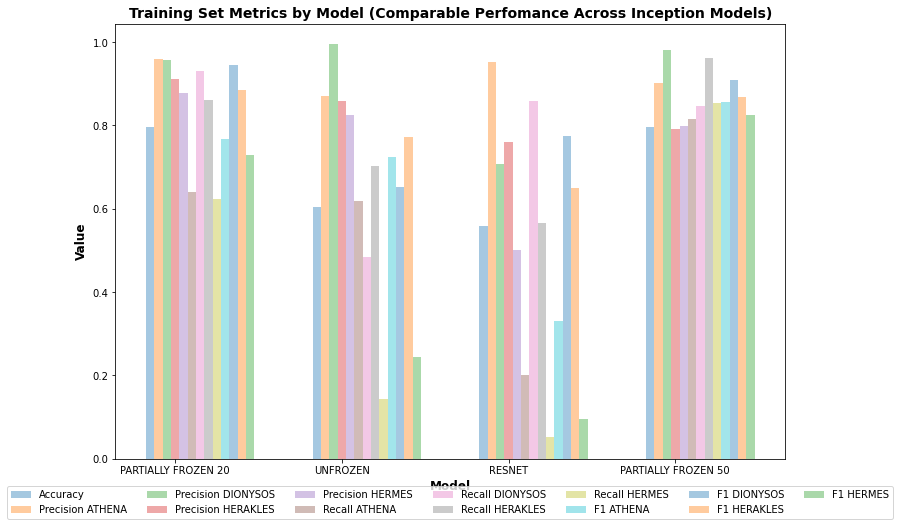

In [16]:
## Bar graph of metrics (mini ablation study)

# Compute training metrics for all models
partial_accu, partial_precision, partial_recall, partial_f1 = return_metrics(partial_freeze, train, labs)
unfrozen_accu, unfrozen_precision, unfrozen_recall, unfrozen_f1 = return_metrics(unfrozen, train, labs)
resnet_accu, resnet_precision, resnet_recall, resnet_f1 = return_metrics(resnet, train, labs)
partial50_accu, partial50_precision, partial50_recall, partial50_f1 = return_metrics(partial_freeze_50, train, labs)

# Compile
metrics = ['Accuracy'] + ['Precision ' + x for x in class_dict] + ['Recall ' + x for x in class_dict] + ['F1 ' + x for x in class_dict]
metrics_df = pd.DataFrame({'Partially_Frozen_20': np.concatenate([np.array([partial_accu]), partial_precision, 
                                                               partial_recall, partial_f1], axis = 0),
                           'Unfrozen' : np.concatenate([np.array([unfrozen_accu]), unfrozen_precision, 
                                                        unfrozen_recall, unfrozen_f1], axis = 0),
                           'Resnet' : np.concatenate([np.array([resnet_accu]), resnet_precision, 
                                                      resnet_recall, resnet_f1], axis = 0),
                           'Partially_Frozen_50' : np.concatenate([np.array([partial50_accu]), partial50_precision, 
                                                      partial50_recall, partial50_f1], axis = 0)
                       },
                         index = metrics)


# Plotting 
pos = np.arange(4) # Y-label positions
width = 0.05  # Bar Width
num_tags = 13
fig, ax = plt.subplots(figsize=(12, 8))

for i in range(num_tags):
    ax.bar(pos + (i*width), metrics_df.iloc[i,:], width, label = metrics[i], alpha = 0.4)


# Addng labels, ticks an legend
ax.set_xlabel('Model', size = 12, weight = 'bold')
ax.set_title('Training Set Metrics by Model (Comparable Perfomance Across Inception Models)', size = 14, weight = 'bold')
ax.set_ylabel('Value', size = 12, weight = 'bold')
ax.set_xticks([pos[0]+6*width, pos[1]+6*width, pos[2]+6*width, pos[3]+6*width])
ax.legend()
ax.set_xticklabels([label.replace("_", " ").replace("model", "").upper() for label in metrics_df.columns])
ax.legend(bbox_to_anchor=(0.5, -0.18), ncol = 7, loc='lower center')
plt.show()

/usr/share/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/share/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


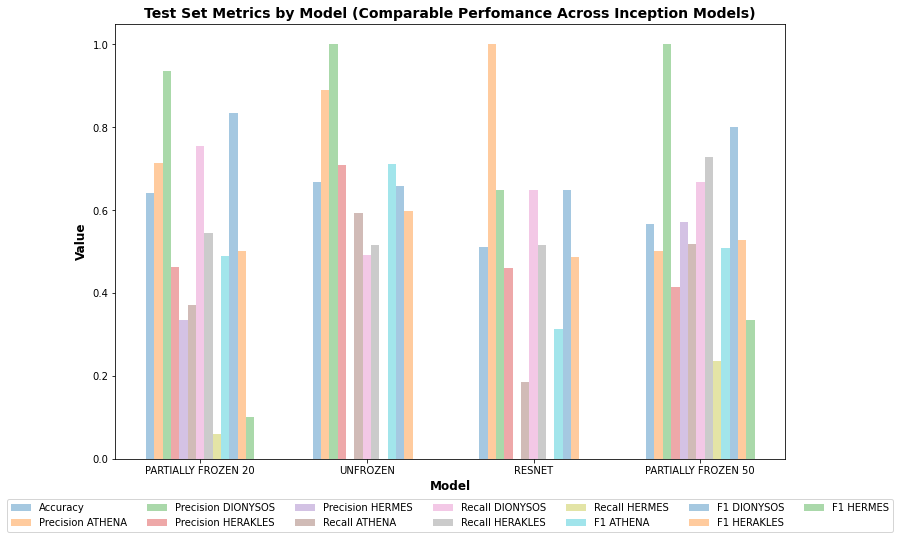

In [17]:
# Compute testing metrics for all models
partial_accu, partial_precision, partial_recall, partial_f1 = return_metrics(partial_freeze, test2, test_labs)
unfrozen_accu, unfrozen_precision, unfrozen_recall, unfrozen_f1 = return_metrics(unfrozen, test2, test_labs)
resnet_accu, resnet_precision, resnet_recall, resnet_f1 = return_metrics(resnet, test2, test_labs)
partial50_accu, partial50_precision, partial50_recall, partial50_f1 = return_metrics(partial_freeze_50, test2, test_labs)

# Compile
metrics = ['Accuracy'] + ['Precision ' + x for x in class_dict] + ['Recall ' + x for x in class_dict] + ['F1 ' + x for x in class_dict]
metrics_df = pd.DataFrame({'Partially_Frozen_20': np.concatenate([np.array([partial_accu]), partial_precision, 
                                                               partial_recall, partial_f1], axis = 0),
                           'Unfrozen' : np.concatenate([np.array([unfrozen_accu]), unfrozen_precision, 
                                                        unfrozen_recall, unfrozen_f1], axis = 0),
                           'Resnet' : np.concatenate([np.array([resnet_accu]), resnet_precision, 
                                                      resnet_recall, resnet_f1], axis = 0),
                           'Partially_Frozen_50' : np.concatenate([np.array([partial50_accu]), partial50_precision, 
                                                      partial50_recall, partial50_f1], axis = 0)
                       },
                         index = metrics)


# Plotting 
pos = np.arange(4) # Y-label positions
width = 0.05  # Bar Width
num_tags = 13
fig, ax = plt.subplots(figsize=(12, 8))

for i in range(num_tags):
    ax.bar(pos + (i*width), metrics_df.iloc[i,:], width, label = metrics[i], alpha = 0.4)


# Addng labels, ticks an legend
ax.set_xlabel('Model', size = 12, weight = 'bold')
ax.set_title('Test Set Metrics by Model (Comparable Perfomance Across Inception Models)', size = 14, weight = 'bold')
ax.set_ylabel('Value', size = 12, weight = 'bold')
ax.set_xticks([pos[0]+6*width, pos[1]+6*width, pos[2]+6*width, pos[3]+6*width])
ax.legend()
ax.set_xticklabels([label.replace("_", " ").replace("model", "").upper() for label in metrics_df.columns])
ax.legend(bbox_to_anchor=(0.5, -0.18), ncol = 7, loc='lower center')
plt.show()

* Precision is the share of true positives out of the sum of true positives and false positives (i.e., out of the sum of all positive predictions). **In this case, precision is the share of images that actually depict the object of interest out of all images predicted to depict the object of interest.** 
    * **If we adjust the classification threshold to increase precision, many of the vases classicist researcher analyze manually will actually show what they are looking for** (i.e., they waste less time browsing through irrelevant vases), **but they may also miss a lot vases that actually depict the object of interest.**
    
    
* Recall is the share of true positives out of the sum of true positives and false negatives (i.e., out of the sum of all positives in the data). **In this case, recall is the share of vases that were correctly predicted to depict the object out of all vases depicting the object.** 
    * **If we adjust the classification threshold to increase recall, the researchers will miss only few of the relevant vases but they may also have to browse through a lot vases that do not actually show the object they are looking for.** 
    
    
* **The F1 score is the harmonic mean of the precision and recall. In this case, it represents the objectives of not wasting time on manually reviewing irrelevant vases (high precision) and not missing any relevant vases (high recall).** 
    * Based on the researchers' preferences, we could use a different threshold for classification, thereby increasing precision or recall.
    
    
* **Note that precision and recall vary widely across the four objects of interest.**
    * For example, F1 score for Dionysos is relatively high, while Hermes proves relatively hard to detect. This is perhaps unsurprising. While Dionysos is almost always depicted with grapevines and in a similar position, Hermes is shown in a variety of positions and his representation closely resembles that of a generic person.
    
   
* **Our model of choice is the inception network with 50 frozen layers as it provides the best balance, both between precision and recall as well as across the four objects of interest.**

In [18]:
#### Extract conv model activation layer and weights for chosen model
resized_conv_out = Lambda(Resize,(INPUT_SIZE, INPUT_SIZE, 3))(conv_output4)
middle_model = Model(input_layer4, [resized_conv_out, output4])
weights = middle_model.get_layer(index = -1).weights[0].numpy() # 2048 x 3

<a id="part4-6"></a>

## 4.6 Visual Inspection: Single Object

[Return to contents](#contents)

We investigate our model’s ability to localize objects. **Note that object detection performance is measured through metrics such as the Jacard Index (i.e. the overlap between the predicted object’s location and its actual location divided by the union) or DICE (i.e. equivalent to F1; two times the overlap between prediction and actual divided by the total number of pixels). However, we lack pixel-level labelling to compute such metrics; therefore it is the reason why we opted for weakly supervised object detection. Thus, we will rely on visual inspection.**

**Despite our lack of pixel-level labels, we believe our approach has merit in understanding not just the ability to detect the object itself, but the context that accompanies these objects.** As we shall see, Dionysos is frequently accompanied by vines, and the model relies on these vines in determining whether Dionysos is depicted and where. Similarly, Herakles is often seen wrestling animals, so the presence of animals assists in detecting his presence. 

Model did not find ATHENA
Model found DIONYSOS


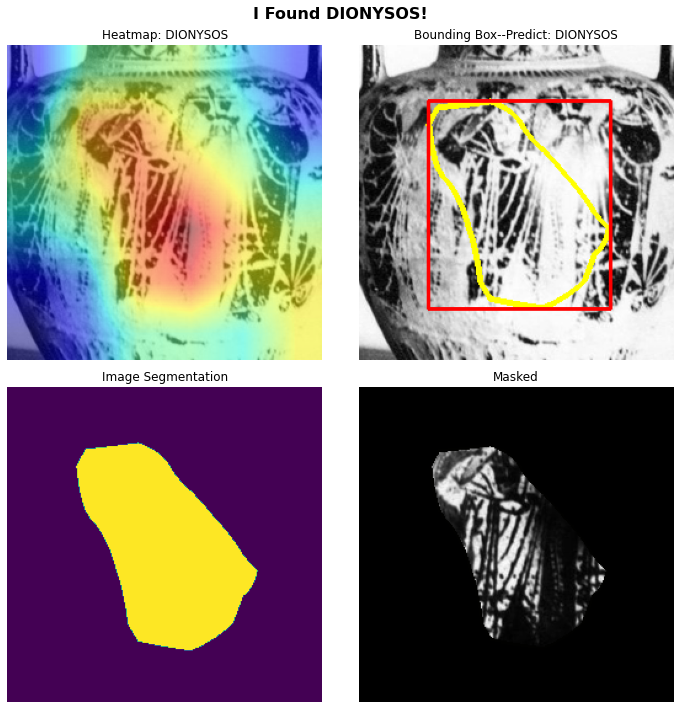

Model did not find HERAKLES
Model did not find HERMES


In [19]:
### Demo: Training

# Choose some image's index (e.g 8)
idx = 19

# Predict
im = train[idx]
found_labels = thresh_pred(partial_freeze.predict(np.expand_dims(im, axis = 0)))[0]

# Show located objects
for i, j in enumerate(found_labels):
    if j == 1:
        print(f'Model found {class_dict[i]}')
        im2 = data[idx]
        img_rgb = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
        img_rgb = cv2.resize(img_rgb, (INPUT_SIZE, INPUT_SIZE))
        visualize_class(middle_model, weights, img_rgb, i, 170)
    else:
        print(f'Model did not find {class_dict[i]}')

**The model correctly determines whether Dionysos is somewhere in the image, and correctly notes no other object is within the image. It generally performs well in localizing where Dionysos is, but it does not capture his full body.** There is a degree of arbitrariness in segmenting the image based on thresholding the heatmaps, one of the model’s weaknesses. Regardless, we view this prediction as a general success, especially given its faded nature and good localization precision and recall.

Model did not find ATHENA
Model did not find DIONYSOS
Model found HERAKLES


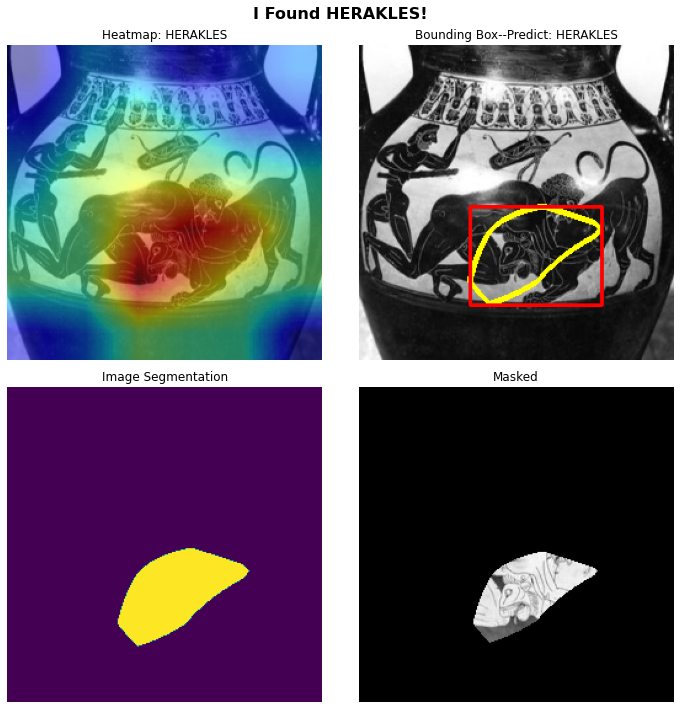

Model did not find HERMES


In [20]:
### Demo: Testing

# Choose some test image's index (e.g. 67)
idx = 40

# Predict
im = test2[idx]
found_labels = thresh_pred(partial_freeze.predict(np.expand_dims(im, axis = 0 )))[0]

# Show located objects
for i, j in enumerate(found_labels):
    if j == 1:
        print(f'Model found {class_dict[i]}')
        im2 = test[idx]
        img_rgb = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
        img_rgb = cv2.resize(img_rgb, (INPUT_SIZE, INPUT_SIZE))
        visualize_class(middle_model, weights, img_rgb, i, 200)
    else:
        print(f'Model did not find {class_dict[i]}')

**The model correctly determines whether Herakles is somewhere in the image, and correctly notes no other object is within the image. It focuses on the interaction of Herakles and the lion (depictions of them wrestling is quite common). Localization is not particularly good in terms of recall (i.e. finding Herakles’ whole body), but precision (i.e. not including irrelevant) can be regarded as quite good if we regard the lion as part of Herakles’ depiction.  Because Herakles is frequently depicted wrestling animals, the prediction raises the question whether a human would have determined Herakles was being depicted without the lion with which he is wrestling? Is it incorrect to consider the lion part of the Herakles depiction?**

Model found ATHENA


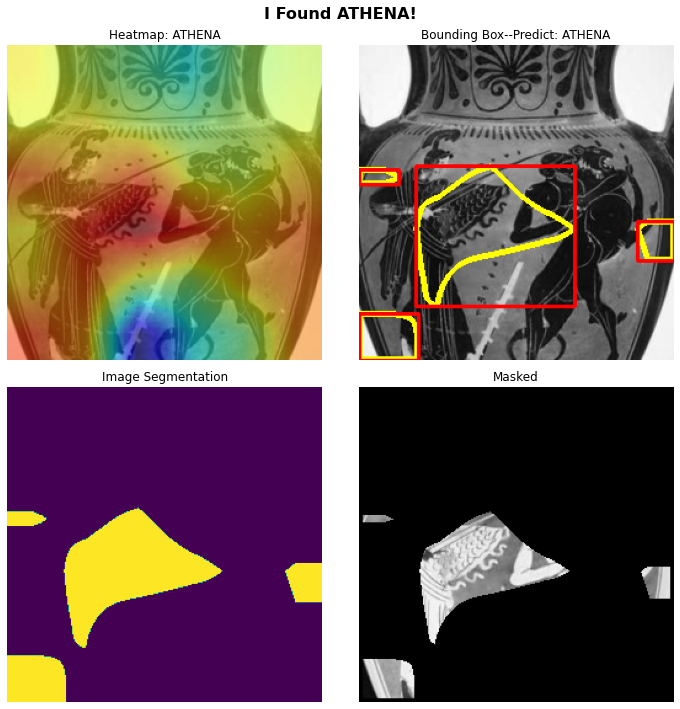

Model did not find DIONYSOS
Model did not find HERAKLES
Model did not find HERMES


In [21]:
# Choose some test image's index (e.g. 67)
idx = 8

# Predict
im = test2[idx]
found_labels = thresh_pred(partial_freeze.predict(np.expand_dims(im, axis = 0 )))[0]

# Show located objects
for i, j in enumerate(found_labels):
    if j == 1:
        print(f'Model found {class_dict[i]}')
        im2 = test[idx]
        img_rgb = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
        img_rgb = cv2.resize(img_rgb, (INPUT_SIZE, INPUT_SIZE))
        visualize_class(middle_model, weights, img_rgb, i, 200)
    else:
        print(f'Model did not find {class_dict[i]}')

**We see one of the model’s weaknesses is that segmentation is not guaranteed to be contiguous, due to the arbitrary nature of determining cut-offs for the CAMs. Localization in this example is mixed, showing a portion of Athena’s body with some irrelevant parts. It failed to detect Herakles, despite his appearance on the vase.**

Model found ATHENA


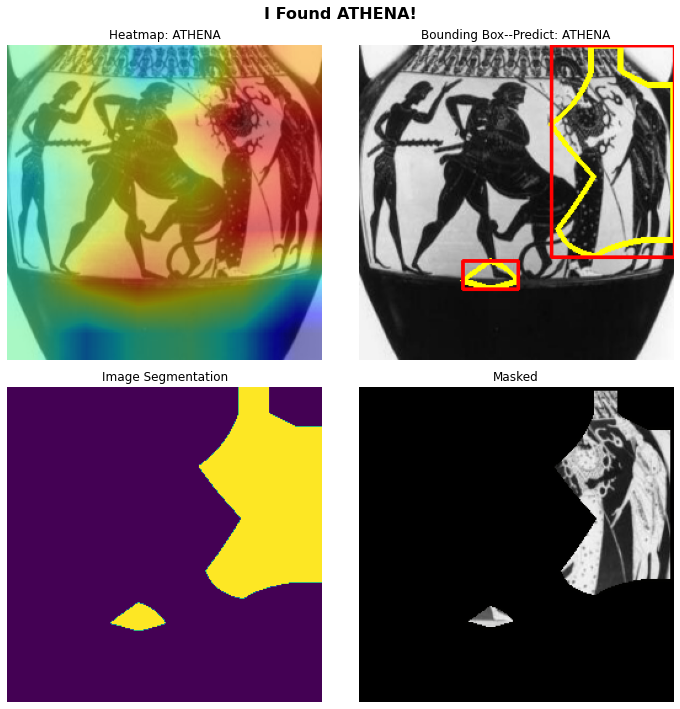

Model did not find DIONYSOS
Model found HERAKLES


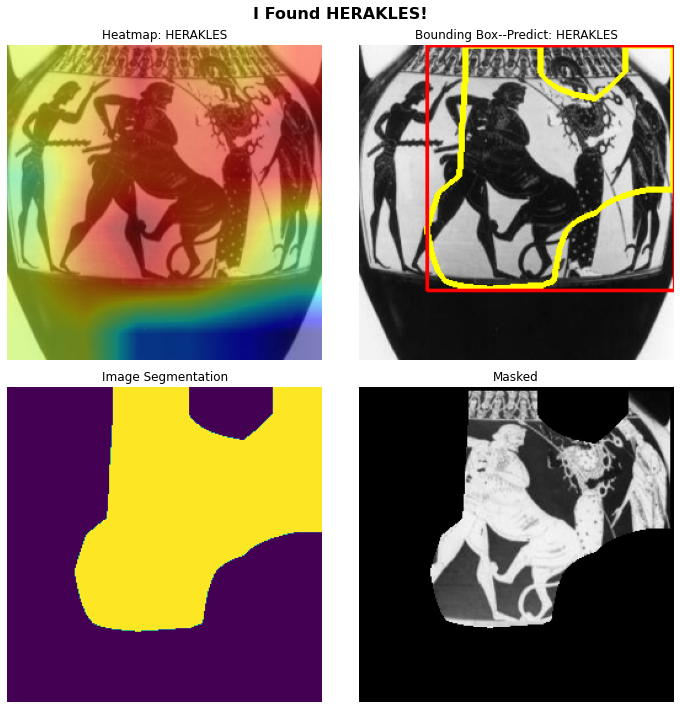

Model did not find HERMES


In [22]:
# Choose some test image's index (e.g. 67)
idx = 51

# Predict
im = test2[idx]
found_labels = thresh_pred(partial_freeze.predict(np.expand_dims(im, axis = 0 )))[0]

# Show located objects
for i, j in enumerate(found_labels):
    if j == 1:
        print(f'Model found {class_dict[i]}')
        im2 = test[idx]
        img_rgb = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
        img_rgb = cv2.resize(img_rgb, (INPUT_SIZE, INPUT_SIZE))
        visualize_class(middle_model, weights, img_rgb, i, 200)
    else:
        print(f'Model did not find {class_dict[i]}')

**The model correctly detected Athena and Herakles but failed to see Hermes. Object localization is good in terms of recall, but not precision. This is possibly a consequence of these objects co-occurring, so the model understands both objects are there, but not who is who.**

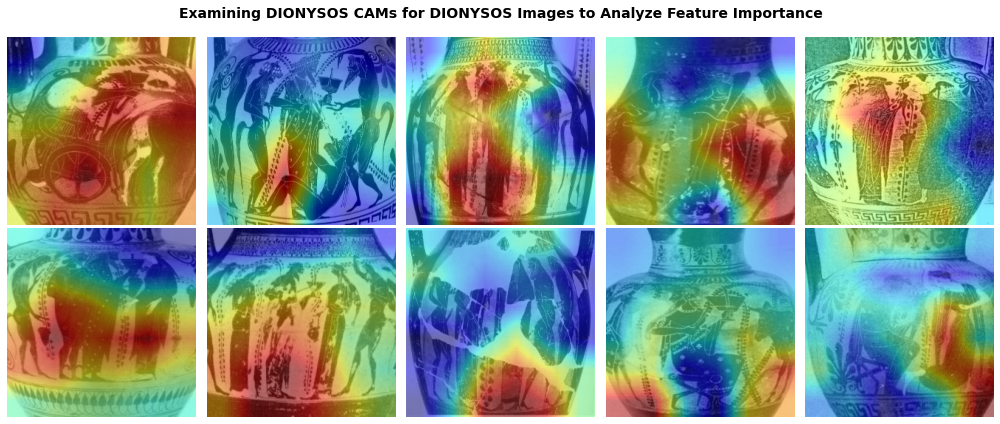

In [24]:
## Dionysos CAMs for a variety of Dionysos images
make_10_CAMS_class(1)

**We examine Dionysos-class CAMs for Dionysos images to understand what features the model most closely examines.** We see that the presence of two vines surrounding a robed person’s body is a major giveaway. The model tends to focus on lower portions of the images with objects’ feet and the vines. We see for some images the model incorrectly focuses on another person or just the vines. **We see that Dionysos is depicted consistently, typically standing up with a kantharos but occasionally sitting down or riding a chariot. The model appears to perform worse in the rarer sort of scenes.**

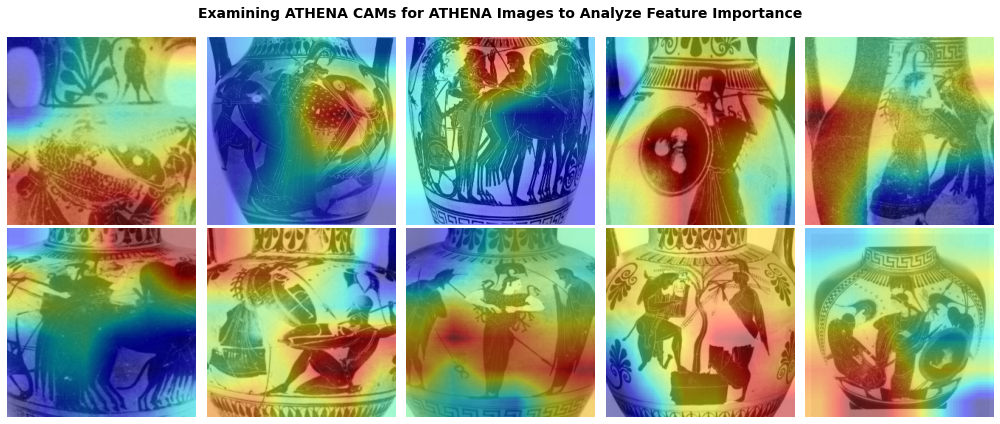

In [23]:
## Athena CAMs for a variety of Athena images
make_10_CAMS_class(0, 10)

Athena is customarily portrayed wearing body armor and a helmet and carrying a shield and a lance. **The Athena class CAMs for Athena images suggest the model generally focused on these elements for detection  – e.g., in several pictures the shield and lance are clearly highlighted. The model had more difficulty with Athena’s uncommon depictions, for example riding a chariot (middle image, upper row).**

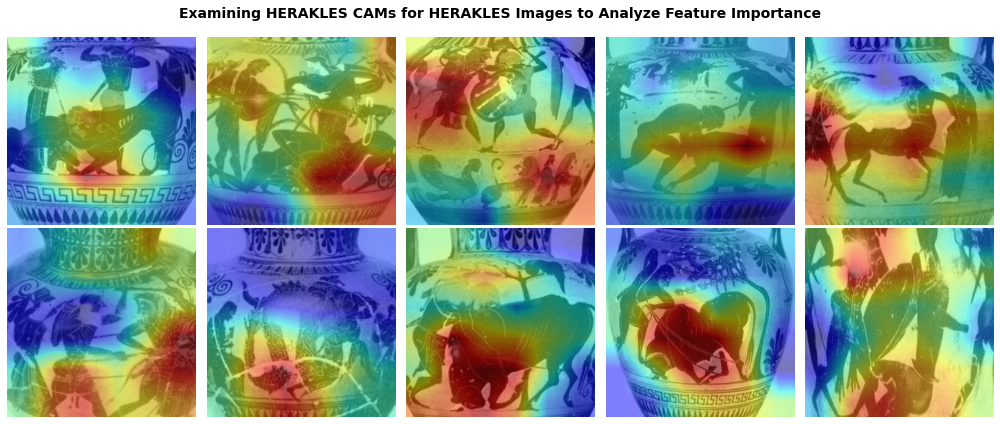

In [25]:
## Herakles CAMs for a variety of Herakles images
make_10_CAMS_class(2)

**We examine Herakles-class CAMs for Herakles images to understand what features the model most closely examines. We noted previously the model struggles more with Herakles test images, and the worse performance compared to Dionysos is shown in object detection.** In 5 images (2, 4, 8, 9 and 10), it localizes Herakles well, with his figure falling in the red zone. In other images, the model appears to be looking at objects frequently depicted with him, such as soldiers, horses or beasts. **We also see that Herakles is depicted in a wider range than Dionysos** (which could be studied through text analysis of available descriptions): **this contributes to Herakles being relatively harder to detect.**

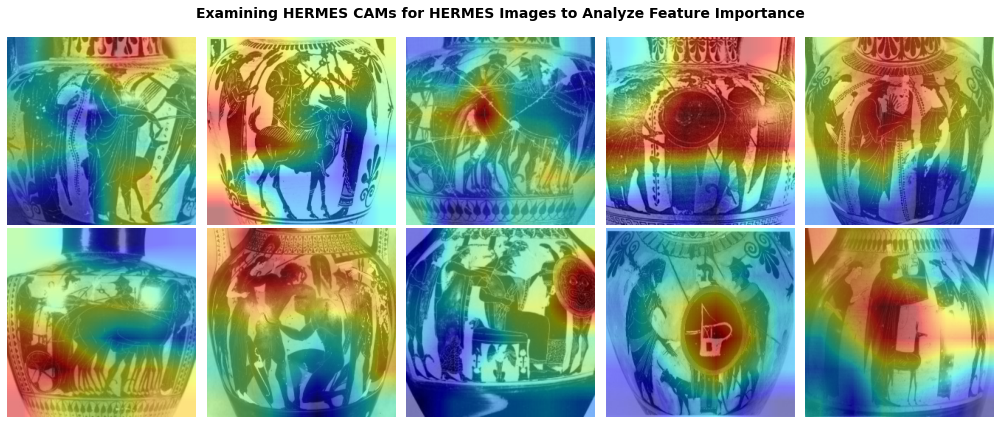

In [26]:
## Hermes CAMs for a variety of Hermes images
make_10_CAMS_class(3)

As noted earlier, there are relatively fewer training images depicting Hermes, and our models did not perform well in detecting this figure. The **Hermes CAMS** also reveal somewhat of a lack in consistency in what elements the model is focusing on for making a prediction. Interestingly, the model appears to somewhat focus on shields even though Hermes is typically not depicted with a shield. A likely explanation is that Hermes is often shown with Athena who often carries a shield. Therefore, the model wrongly picks up on shields as an identifying feature of Hermes.

<a id="part4-7"></a>

## 4.7 Visual Inspection: Multiple Objects

[Return to contents](#contents)

We examine our model's ability to detect objects simultaneously with greater emphasis in this section.

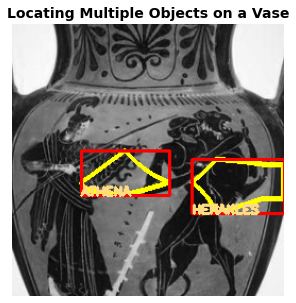

In [27]:
## Testing on the multi-label set
im2 = test[np.where(test_labs.sum(axis = 1)==2)[0][0]]
img_rgb = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
img_rgb = cv2.resize(img_rgb, (INPUT_SIZE, INPUT_SIZE))
CAM_0 = output_CAM_class(middle_model, weights, img_rgb, 0)[0]
CAM_2 = output_CAM_class(middle_model, weights, img_rgb, 2)[0]

# Draw
draw_CAM_countours([CAM_0, CAM_2], [0,2], img_rgb, 225)

# Plot
plt.figure(figsize=(5, 5))
plt.imshow(img_rgb)
plt.axis('off')
plt.title('Locating Multiple Objects on a Vase', size = 14, weight = 'bold')
plt.show()

**The sample above depicts a surprising success. Though the model does not localize the objects well, as displayed by the bounding box, it surprisingly places those boxes correctly on the objects.** The model displays good understanding of the differences between these two objects.

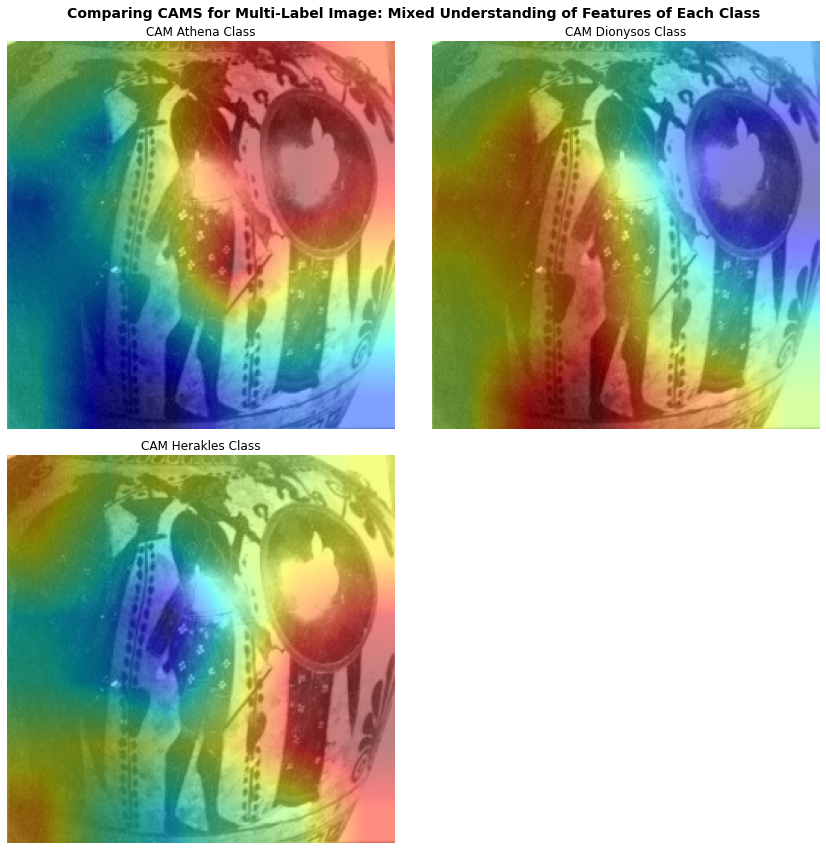

In [28]:
## Investigating heatmaps for another multi-label image

# Pre-process
im2 = test[np.where(test_labs.sum(axis = 1)==3)[0][1]]
img_rgb = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
img_rgb = cv2.resize(img_rgb, (INPUT_SIZE, INPUT_SIZE))

# Heatmaps
heatmap0 = output_CAM_class(middle_model, weights, img_rgb, 0)[0]
heatmap1 = output_CAM_class(middle_model, weights, img_rgb, 1)[0]
heatmap2 = output_CAM_class(middle_model, weights, img_rgb, 2)[0]

# Plot
fig, axes = plt.subplots(2, 2, figsize = (12, 12))
axes = axes.flatten()
axes[0].imshow(img_rgb)
axes[0].imshow(heatmap0, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
axes[0].axis('off')
axes[0].set_title(f'CAM Athena Class')
axes[1].imshow(img_rgb)
axes[1].imshow(heatmap1, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
axes[1].axis('off')
axes[1].set_title(f'CAM Dionysos Class')
axes[2].imshow(img_rgb)
axes[2].imshow(heatmap2, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
axes[2].axis('off')
axes[2].set_title(f'CAM Herakles Class')
axes[3].remove()
plt.suptitle('Comparing CAMS for Multi-Label Image: Mixed Understanding of Features of Each Class', size = 14, weight = 'bold')
fig.tight_layout()
plt.show()

**We see that the CAMs display coherent distinctions. The model correctly notes that the left part of the image corresponds more closely with Dionysos and the right part with Athena. It is partly confusing Herakles with Athena, who frequently appears with him in the same images.** Regardless, this provides more evidence of proper object detection.

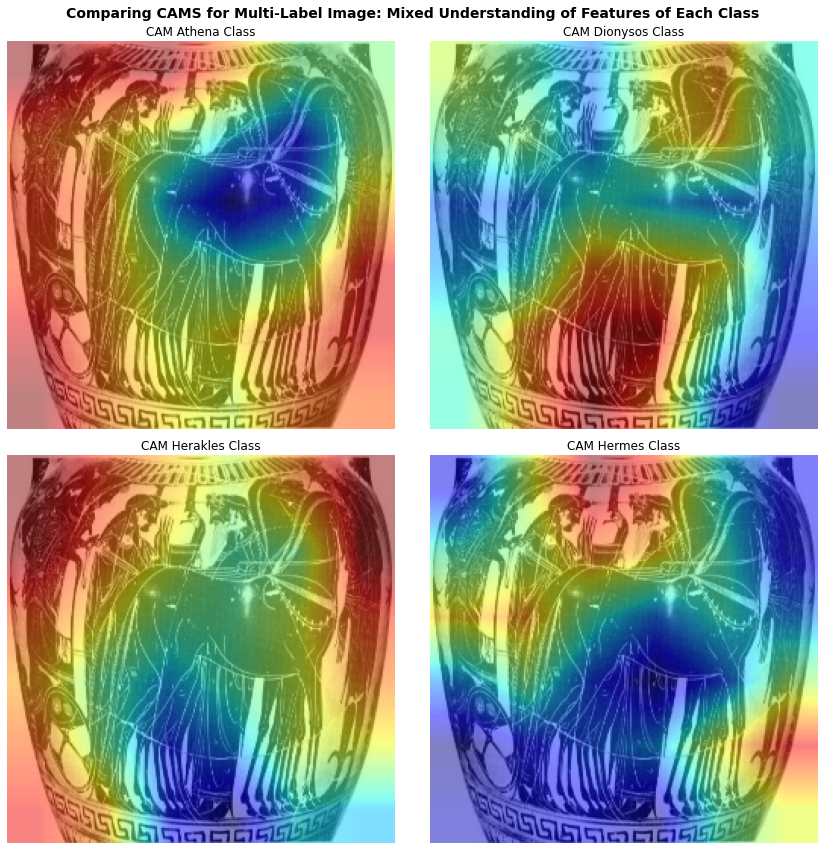

In [29]:
## Investigating heatmaps for another multi-label image

# Pre-process
im2 = test[np.where(test_labs.sum(axis = 1)==4)[0][0]]
img_rgb = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
img_rgb = cv2.resize(img_rgb, (INPUT_SIZE, INPUT_SIZE))

# Heatmaps
heatmap0 = output_CAM_class(middle_model, weights, img_rgb, 0)[0]
heatmap1 = output_CAM_class(middle_model, weights, img_rgb, 1)[0]
heatmap2 = output_CAM_class(middle_model, weights, img_rgb, 2)[0]
heatmap3 = output_CAM_class(middle_model, weights, img_rgb, 3)[0]

# Plot
fig, axes = plt.subplots(2, 2, figsize = (12, 12))
axes = axes.flatten()
axes[0].imshow(img_rgb)
axes[0].imshow(heatmap0, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
axes[0].axis('off')
axes[0].set_title(f'CAM Athena Class')
axes[1].imshow(img_rgb)
axes[1].imshow(heatmap1, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
axes[1].axis('off')
axes[1].set_title(f'CAM Dionysos Class')
axes[2].imshow(img_rgb)
axes[2].imshow(heatmap2, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
axes[2].axis('off')
axes[2].set_title(f'CAM Herakles Class')
axes[3].imshow(img_rgb)
axes[3].imshow(heatmap3, cmap=plt.cm.jet, alpha=0.5, interpolation='nearest')
axes[3].axis('off')
axes[3].set_title(f'CAM Hermes Class')
plt.suptitle('Comparing CAMS for Multi-Label Image: Mixed Understanding of Features of Each Class', size = 14, weight = 'bold')
fig.tight_layout()
plt.show()

**The CAMs above show the model’s value in detecting where objects are, even if exact localization is not achieved. The heatmaps for Dionysos and Herakles strongly overlap with where the objects actually are (in the middle and on the left). Hermes (far right) remains elusive, however, and the model does not know where to look. It understands that if a woman and Herakles are depicted together, that woman is likely Athena.**

<a id="part4-7"></a>

## 4.7 Strengths and Weaknesses

[Return to contents](#contents)

**1) For most objects, the model performs well in detecting whether they are in the image but less successful in localizing them. For tagging purposes, perhaps it is unnecessary to properly localize the objects, but doing so assists humans in confirming the model’s answers. The use of heatmaps could prove sufficient to assist in automatically labelling archives, as masks and bounding boxes rely on subjective cut-offs.**

**2) The model’s greatest strength is its sparse requirements, requiring to just know whether an object is somewhere on the image rather than where. This suits pre-existing archives’ limitations.**

**3) Whether the model relies on particular objects or general contexts is unclear. It appears to rely on a mix of the two—just as humans do.** For example, the presence of vines is a strong indication of Dionysos’s presence. On the other hand, the combination of men and animals is more indicative of Herakles, rather than the man himself.

**4) The model generally succeeds in showing the approximate location of objects, but is not precise in identifying the exact area.**

<a id="part4-8"></a>

## 4.8 Future Work

[Return to contents](#contents)

There are several potential avenues to further improve this work:

1) We could implement **more sophisticated weakly supervised models** (e.g. self-attention) as done in [Huang et al. (2020)](https://paperswithcode.com/paper/comprehensive-attention-self-distillation-for).

2) We could **combine unsupervised object segmentation with heatmaps to better locate images** (e.g. find the hottest area, locate in which segment it falls, and using that as the detected object). For example, by first segmenting the objects using unsupervised methods, then determining the “hottest” areas in the CAMs, and finally mapping the hottest areas to the segmented image, we could force the instance segmentation to be contiguous. 

3) We could **incorporate a wider array of objects, especially non-humans.**

4) We could **use transfer learning from more similar datasets**, such as water paintings or comic books ([Gonthier et al. 2018](https://arxiv.org/abs/1810.02569)).

5) We could also further **improve the quality of the training data by improving cropping** and **potentially adding synthetic images of objects that frequently co-occur with other objects** (e.g. Hermes).

<a id="part5"></a>

# 5. Introspective Variational AutoEncoder (IntroVAE)

[Return to contents](#contents)

<a id="part5-1"></a>
## 5.1 Motivation
[Return to contents](#contents)

In this section, we create **an introspective variational autoencoder (IntroVAE)** model as described by [Huang et al. 2019](https://arxiv.org/pdf/1807.06358.pdf). The motivation for this approach is that **if the autoencoder reconstructs images at high quality, we can apply a clustering algorithm to the latent space to detect emergent categories.** If the event classes/clusters align with meaningful interpretations (e.g., does the image show Dionysos?), then we could also generate vectors from that region in the latent space to create more datapoints for training. 

**IntoVAEs have the same qualities of a VAE, but train the encoder and the generator parts of the model iteratively on different loss functions.** Both the encoder loss and generator loss include minimizing the MSE between the original image and the generated image after passing through both the encoder and generator. The encoder loss also includes KL divergence loss, KL divergence loss after freezing the weights for the generator and encoding the output a second time, as well as KL divergence loss after encoding a randomly generated latent space freezing the weights for the generator and encoding the output a second time. The generator loss also includes KL divergence loss and KL divergence loss after passing a randomly generated latent space through the generator and encoder. 

Our work draws in particular on section "3.3 Training IntroVAE networks" on pp. 5-6 and "C Illustration of training flow" on p. 15 in [Huang et al. 2019](https://arxiv.org/pdf/1807.06358.pdf).

In [2]:
tf.config.experimental.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

<a id="part5-2"></a>

## 5.2 Custom Losses
[Return to contents](#contents)

Alpha and beta are weights for KL divergence losses and the MSE between input and output respectively. Code for custom loss and custom IVAE class adapted from [here](https://github.com/bbeatrix/introvae/).

In [3]:
def custom_eloss(enc_input, xr, z_mu, z_log_var, zr_mu_ng, zr_log_var_ng, zpp_mu_ng, zpp_log_var_ng, 
                 alpha= 0.25, beta= 0.05, m= 100):
    
    loss = (((losses.reg_loss(z_mu, z_log_var)) + # LREG(Z)
                 alpha * (K.maximum(0.0, m - losses.reg_loss(zr_mu_ng, zr_log_var_ng))) + # LREG(Zr)
                 alpha * K.maximum(0.0, m - losses.reg_loss(zpp_mu_ng, zpp_log_var_ng))) # LREG(Zpp)
                +
                beta 
                * 
                losses.mse_loss(enc_input, xr, (256, 384))) # LAE
    
    return loss

def custom_gloss(enc_input, xr_latent, z_mu, z_log_var, zpp_mu, zpp_log_var, 
                 alpha= 0.25, beta= 0.05):
    
    loss = ((alpha * losses.reg_loss(z_mu, z_log_var) + # LREG(Z)
             alpha * (losses.reg_loss(zpp_mu, zpp_log_var))) + # LREG(Zp)
             beta * 
             losses.mse_loss(enc_input, xr_latent, (256, 384))) # LAE
    
    return loss

<a id="part5-3"></a>

## 5.3 Custom Classes
[Return to contents](#contents)

The "Sampling" class allows the model to learn a mean and variance for the distribution underlying the embedding layer by sampling an epsilon while training the model subject to: $\epsilon$ ~ $N(0,1)$

And constructing the embedding layer: $embedding = mean + (\epsilon * variance)$

In [4]:
class Sampling(tf.keras.layers.Layer):
    
    """
    Sampling layer in latent space.
    Uses (z_mean, z_log_var) to sample z.
    """

    def call(self, inputs):
        """Rturns a random sample from a Gaussian with mean and 
        log-variance indicated in inputs.
        
        Inputs:
        -inputs: tuple (z_mean, z_log_var)
        
        Returns a sample z drawn from Gaussian.
        """
        z_mean, z_log_var = inputs
        
        e = tf.random.normal((tf.shape(z_mean)[0], 256), mean = 0, stddev = 1)
        z = z_mean + (tf.exp(0.5 * z_log_var) * e)
        
        return z, z_mean, z_log_var
    
class IVAE(Model):
    def __init__(self, encoder, generator, latent_dim):
        super(IVAE, self).__init__()
        self.encoder = encoder
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, e_optimizer, g_optimizer, eloss_fn, gloss_fn):
        super(IVAE, self).compile()
        self.e_optimizer = e_optimizer
        self.g_optimizer = g_optimizer
        self.eloss_fn = eloss_fn
        self.gloss_fn = gloss_fn

    def train_step(self, images):
        if isinstance(images, tuple):
            images = images[0]
        
        batch_size = tf.shape(images)[0]

        # Train the encoder
        with tf.GradientTape() as tape:
            
            z, z_mu, z_log_var = self.encoder(images)
            xr = self.generator(z)
            zr, zr_mu, zr_log_var = self.encoder(self.generator(z))
            zr_ng, zr_mu_ng, zr_log_var_ng = self.encoder(tf.stop_gradient(self.generator(z)))
            zp = tf.random.normal((batch_size, self.latent_dim), mean = 0, stddev = 1)
            zpp, zpp_mu_ng, zpp_log_var_ng = self.encoder(tf.stop_gradient(self.generator(zp)))
            
            encoder_loss = self.eloss_fn(images, xr, z_mu, z_log_var, zr_mu_ng, zr_log_var_ng, 
                                         zpp_mu_ng, zpp_log_var_ng)
            
            
        grads = tape.gradient(encoder_loss, self.encoder.trainable_weights)
        self.e_optimizer.apply_gradients(zip(grads, self.encoder.trainable_weights))

        # Train the generator
        with tf.GradientTape() as tape:
            
            z, z_mu, z_log_var = self.encoder(images)
            xr_latent = self.generator(z)
                                  
            zp = tf.random.normal((batch_size, self.latent_dim), mean = 0, stddev = 1)
            zpp, zpp_mu, zpp_log_var = self.encoder(self.generator(zp))
            
            generator_loss = self.gloss_fn(images, xr_latent, z_mu, z_log_var, zpp_mu, zpp_log_var)
            
            
        grads = tape.gradient(generator_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))
        return {"e_loss": encoder_loss, "g_loss": generator_loss}

<a id="part5-4"></a>

## 5.4 Encoder
[Return to contents](#contents)


In [24]:
enc_input = Input(shape = (256, 384, 1), name= 'enc_input')

# ---BLOCK 0---
# Purpose of the "add" blocks is to create a residual block
enc_conv2d_0_0 = Conv2D(filters= 12, kernel_size= (3, 3), strides = (2, 2), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_0_0')(enc_input)

bn_0 = BatchNormalization(name= 'batch_norm_0')(enc_conv2d_0_0)
enc_conv2d_0_1 = Conv2D(filters= 12, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_0')(bn_0)
add_0 = Add(name= 'add_0')([bn_0, enc_conv2d_0_1])

# ---BLOCK 1---
enc_conv2d_1_0 = Conv2D(filters= 24, kernel_size= (3, 3), strides = (2, 2), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_1_0')(add_0)

bn_1 = BatchNormalization(name= 'batch_norm_1')(enc_conv2d_1_0)
enc_conv2d_1_1 = Conv2D(filters= 24, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_1_1')(bn_1)
add_1 = Add(name= 'add_1')([bn_1, enc_conv2d_1_1])

# ---BLOCK 2---
enc_conv2d_2_0 = Conv2D(filters= 36, kernel_size= (3, 3), strides = (2, 2), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_2_0')(add_1)

bn_2 = BatchNormalization(name= 'batch_norm_2')(enc_conv2d_2_0)
enc_conv2d_2_1 = Conv2D(filters= 36, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_2_1')(bn_2)
add_2 = Add(name= 'add_2')([bn_2, enc_conv2d_2_1])

# ---BLOCK 3---
enc_conv2d_3_0 = Conv2D(filters= 48, kernel_size= (3, 3), strides = (2, 2), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_3_0')(add_2)

bn_3 = BatchNormalization(name= 'batch_norm_3')(enc_conv2d_3_0)
enc_conv2d_3_1 = Conv2D(filters= 48, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_3_1')(bn_3)
add_3 = Add(name= 'add_3')([bn_3, enc_conv2d_3_1])

# ---BLOCK 4---
enc_conv2d_4_0 = Conv2D(filters= 64, kernel_size= (3, 3), strides = (2, 2), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_4_0')(add_3)

bn_4 = BatchNormalization(name= 'batch_norm_4')(enc_conv2d_4_0)
enc_conv2d_4_1 = Conv2D(filters= 64, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_4_1')(bn_4)
add_4 = Add(name= 'add_4')([bn_4, enc_conv2d_4_1])

# ---BLOCK 5---
enc_conv2d_5_0 = Conv2D(filters= 96, kernel_size= (3, 3), strides = (2, 2), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_5_0')(add_4)

bn_5 = BatchNormalization(name= 'batch_norm_5')(enc_conv2d_5_0)
enc_conv2d_5_1 = Conv2D(filters= 96, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                        activation= 'relu', kernel_initializer= 'he_normal', name= 'enc_conv2d_5_1')(bn_5)
add_5 = Add(name= 'add_5')([bn_5, enc_conv2d_5_1])

# ---FLATTEN---

bn_6 = BatchNormalization(name= 'batch_norm_6')(add_5)
flatten = Flatten(name= 'flatten')(add_5)
# ---SAMPLING---

mu = Dense(256, name= 'mu')(flatten)
log_var = Dense(256, name= 'log_var')(flatten)

z, z_mu, z_log_var = Sampling(name= 'sampling')([mu, log_var])

In [25]:
ivae_encoder = tf.keras.Model(inputs= enc_input, outputs= [z, z_mu, z_log_var], name= 'IVAE_Encoder')
ivae_encoder.summary()

Model: "IVAE_Encoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
enc_input (InputLayer)          [(None, 256, 384, 1) 0                                            
__________________________________________________________________________________________________
enc_conv2d_0_0 (Conv2D)         (None, 128, 192, 12) 120         enc_input[0][0]                  
__________________________________________________________________________________________________
batch_norm_0 (BatchNormalizatio (None, 128, 192, 12) 48          enc_conv2d_0_0[0][0]             
__________________________________________________________________________________________________
enc_conv2d_0 (Conv2D)           (None, 128, 192, 12) 1308        batch_norm_0[0][0]               
_______________________________________________________________________________________

<a id="part5-5"></a>

## 5.5 Generator
[Return to contents](#contents)


In [26]:
# Generator
gen_input = Input(shape= 256, name = 'gen_input')
dropout = Dropout(0.1, name= 'dropout_0')(gen_input)
dense_0 = Dense(2304, name= 'dense_0')(dropout)
reshape_0 = Reshape((4, 6, 96), name= 'reshape_0')(dense_0)

# ---BLOCK 0---
gen_conv_2dt_0 = Conv2DTranspose(96, kernel_size=(2, 2), strides= (2, 2), name= 'gen_conv_2dt_0')(reshape_0)

gen_bn_0 = BatchNormalization(name= 'gen_batch_norm_0')(gen_conv_2dt_0)
gen_conv2d_0 = Conv2D(filters= 96, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                      activation= 'relu', kernel_initializer= 'he_normal', name= 'gen_conv2d_0')(gen_bn_0)
gen_add_0 = Add(name= 'gen_add_0')([gen_bn_0, gen_conv2d_0])

# ---BLOCK 1---
gen_conv_2dt_1 = Conv2DTranspose(64, kernel_size=(2, 2), strides= (2, 2), name= 'gen_conv_2dt_1')(gen_add_0)

gen_bn_1 = BatchNormalization(name= 'gen_batch_norm_1')(gen_conv_2dt_1)
gen_conv2d_1 = Conv2D(filters= 64, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                      activation= 'relu', kernel_initializer= 'he_normal', name= 'gen_conv2d_1')(gen_bn_1)
gen_add_1 = Add(name= 'gen_add_1')([gen_bn_1, gen_conv2d_1])

# ---BLOCK 2---
gen_conv_2dt_2 = Conv2DTranspose(48, kernel_size=(2, 2), strides= (2, 2), name= 'gen_conv_2dt_2')(gen_add_1)

gen_bn_2 = BatchNormalization(name= 'gen_batch_norm_2')(gen_conv_2dt_2)
gen_conv2d_2 = Conv2D(filters= 48, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                      activation= 'relu', kernel_initializer= 'he_normal', name= 'gen_conv2d_2')(gen_bn_2)
gen_add_2 = Add(name= 'gen_add_2')([gen_bn_2, gen_conv2d_2])

# ---BLOCK 3---
gen_conv_2dt_3 = Conv2DTranspose(32, kernel_size=(2, 2), strides= (2, 2), name= 'gen_conv_2dt_3')(gen_add_2)

gen_bn_3 = BatchNormalization(name= 'gen_batch_norm_3')(gen_conv_2dt_3)
gen_conv2d_3 = Conv2D(filters= 32, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                      activation= 'relu', kernel_initializer= 'he_normal', name= 'gen_conv2d_3')(gen_bn_3)
gen_add_3 = Add(name= 'gen_add_3')([gen_bn_3, gen_conv2d_3])

# ---BLOCK 4---
gen_conv_2dt_4 = Conv2DTranspose(24, kernel_size=(2, 2), strides= (2, 2), name= 'gen_conv_2dt_4')(gen_add_3)

gen_bn_4 = BatchNormalization(name= 'gen_batch_norm_4')(gen_conv_2dt_4)
gen_conv2d_4 = Conv2D(filters= 24, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                      activation= 'relu', kernel_initializer= 'he_normal', name= 'gen_conv2d_4')(gen_bn_4)
gen_add_4 = Add(name= 'gen_add_4')([gen_bn_4, gen_conv2d_4])

# ---BLOCK 5---
gen_conv_2dt_5 = Conv2DTranspose(12, kernel_size=(2, 2), strides= (2, 2), name= 'gen_conv_2dt_5')(gen_add_4)

gen_bn_5 = BatchNormalization(name= 'gen_batch_norm_5')(gen_conv_2dt_5)
gen_conv2d_5 = Conv2D(filters= 12, kernel_size= (3, 3), strides = (1, 1), padding = 'same', 
                      activation= 'relu', kernel_initializer= 'he_normal', name= 'gen_conv2d_5')(gen_bn_5)
gen_add_5 = Add(name= 'gen_add_5')([gen_bn_5, gen_conv2d_5])

# ---OUTPUT---
gen_bn_6 = BatchNormalization(name= 'gen_batch_norm_6')(gen_add_5)
gen_output = Conv2DTranspose(filters= 1, kernel_size= (1, 1), activation= 'sigmoid', name= 'output')(gen_bn_6)

In [27]:
ivae_generator = tf.keras.Model(inputs= gen_input, outputs= gen_output, name= 'IVAE_Generator')
ivae_generator.summary()

Model: "IVAE_Generator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
gen_input (InputLayer)          [(None, 256)]        0                                            
__________________________________________________________________________________________________
dropout_0 (Dropout)             (None, 256)          0           gen_input[0][0]                  
__________________________________________________________________________________________________
dense_0 (Dense)                 (None, 2304)         592128      dropout_0[0][0]                  
__________________________________________________________________________________________________
reshape_0 (Reshape)             (None, 4, 6, 96)     0           dense_0[0][0]                    
_____________________________________________________________________________________

<a id="part5-6"></a>

## 5.6 Loading data
[Return to contents](#contents)


In [10]:
# Unzipping folders with smart cropped images

parent = 'Cropped/'
cat = ['DIONYSOS', 'HERAKLES', 'NULL']

#--------------------------------------------------------
# If directory is already unzipped then comment from here

for i in range(len(cat)):
    
    directories = os.listdir(parent + '/' + cat[i])
    
    for directory in directories:
        
        if directory[-3:] == 'zip':
            
            path = parent + '/' + cat[i] + '/' + directory
            with zipfile.ZipFile(path, 'r') as zipf:
                zipf.extractall(path[:-4])
                
# To here
#--------------------------------------------------------


# opening images, resizing, and converting to numpy arrays
ids = [[1, 0, 0], [0, 1, 0], [0, 0, 1]]

images = []
classes = []

for i in range(len(cat)):
    
    pc = parent + cat[i]
    image_paths = glob.glob(pc + '/*/*/*.jpg')
    
    for path in image_paths:
            
        image = PIL.Image.open(path)
        gray = cv2.cvtColor(np.float32(image), cv2.COLOR_RGB2GRAY)
        res = cv2.resize(gray, dsize=(384, 256), interpolation=cv2.INTER_CUBIC)
        norm = np.asarray(res) / 255
        images.append(norm) 
        classes.append(ids[i])
        
images = np.array(images)
images = np.expand_dims(images, axis= 3)
classes = np.array(classes)

<a id="part5-7"></a>

## 5.7 Optimizers and Fitting Model
[Return to contents](#contents)


In [22]:
# Optimizers
encoder_optimizer = tf.keras.optimizers.Adam(learning_rate= 2e-4)
generator_optimizer = tf.keras.optimizers.Adam(learning_rate= 2e-4)

In [11]:
#Creating a data pipeline for training in TensorFlow

img_tr, img_val, class_tr, class_val  = train_test_split(images, classes, test_size = 0.12, random_state= 6829)
print(img_tr.shape, img_val.shape, class_tr.shape, class_val.shape)

# Below code dynamically augments the data as it is fed into the model for training
img_in = Input(shape = (256, 384, 1), name= 'Img_In')
flip = RandomFlip(mode= 'horizontal', name= 'Flip')(img_in)
translation = RandomTranslation(height_factor= 0.15, width_factor= 0.15, 
                                interpolation= 'bilinear', name= 'Translate')(flip)
rotation = RandomRotation(factor= 0.15, name= 'Rotate')(translation)
img_out = RandomZoom(height_factor= 0.15, width_factor= 0.15, name= 'Img_Out')(rotation)

data_aug = tf.keras.Model(inputs= img_in, outputs= img_out, name= 'Data_Augmentation')

shuffle = 256
batch_size = 32

dio_tr = tf.data.Dataset.from_tensor_slices((img_tr, img_tr))
dio_tr = (dio_tr.shuffle(shuffle)
          .batch(batch_size)
          .prefetch(1)
          .map(lambda x, y: data_aug(x, training= True))
          .map(lambda x: ((x, x))))

dio_val = tf.data.Dataset.from_tensor_slices((img_val, img_val))
dio_val = (dio_val.shuffle(shuffle)
           .batch(batch_size)
           .prefetch(1)
           .map(lambda x, y: data_aug(x, training= True))
           .map(lambda x: (x, x)))

(1576, 256, 384, 1) (216, 256, 384, 1) (1576, 3) (216, 3)


In [28]:
ivae_encoder = tf.keras.Model(inputs= enc_input, outputs= [z, z_mu, z_log_var], name= 'IVAE_Encoder')
ivae_generator = tf.keras.Model(inputs= gen_input, outputs= gen_output, name= 'IVAE_Generator')

ivae = IVAE(encoder= ivae_encoder, generator= ivae_generator, latent_dim= 256)
ivae.compile(e_optimizer= encoder_optimizer, g_optimizer= generator_optimizer, 
             eloss_fn= custom_eloss, gloss_fn= custom_gloss)
history = ivae.fit(dio_tr, epochs= 100, verbose= True)

Epoch 1/100
50/50 [==============================] - 95s 2s/step - e_loss: 17262776.4000 - g_loss: 1043.5786
Epoch 2/100
50/50 [==============================] - 86s 2s/step - e_loss: 511.8895 - g_loss: 450.5321
Epoch 3/100
50/50 [==============================] - 86s 2s/step - e_loss: 506.1099 - g_loss: 436.4814
Epoch 4/100
50/50 [==============================] - 86s 2s/step - e_loss: 503.6167 - g_loss: 413.5783
Epoch 5/100
50/50 [==============================] - 86s 2s/step - e_loss: 489.6654 - g_loss: 407.1763
Epoch 6/100
50/50 [==============================] - 86s 2s/step - e_loss: 456.8847 - g_loss: 367.5814
Epoch 7/100
50/50 [==============================] - 86s 2s/step - e_loss: 417.7846 - g_loss: 323.4887
Epoch 8/100
50/50 [==============================] - 86s 2s/step - e_loss: 403.4308 - g_loss: 309.4653
Epoch 9/100
50/50 [==============================] - 86s 2s/step - e_loss: 391.2238 - g_loss: 298.4235
Epoch 10/100
50/50 [==============================] - 86s 2s/step -

<a id="part5-8"></a>

## 5.8 Results
[Return to contents](#contents)


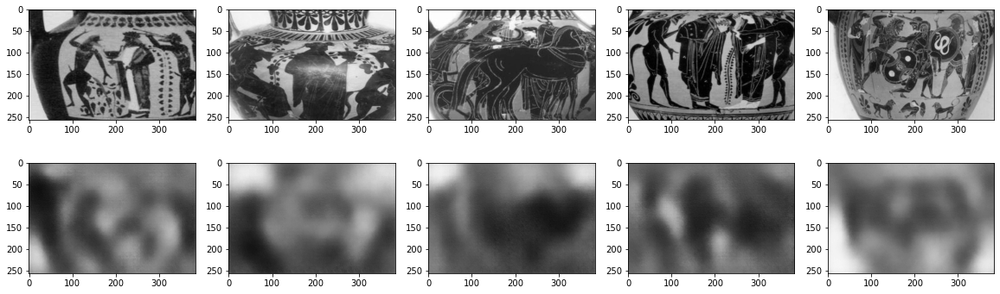

In [29]:
a = np.array(range(img_val.shape[0]))
random_n = np.random.choice(a, 5, replace= False)

fig, axs = plt.subplots(2, 5)
fig.set_figwidth(20)
fig.set_figheight(6)
axl = axs.ravel()

for i in range(5):
    
    image = img_val[random_n[i]]
    j = i * 2
    
    axl[i].imshow(image, cmap= 'gray', vmin=0.0, vmax=1.0)
    
    image = np.expand_dims(image, axis= 0)
    z, z_mu, z_logvar = ivae_encoder.predict(image)
    pred = ivae_generator.predict(z)
    pred = pred[0,:,:,0]
    
    axl[i+5].imshow(pred, cmap= 'gray', vmin=0.0, vmax=1.0)

**Unfortunately, the reconstructed images are blurry, and it is not possible to detect objects on them.**

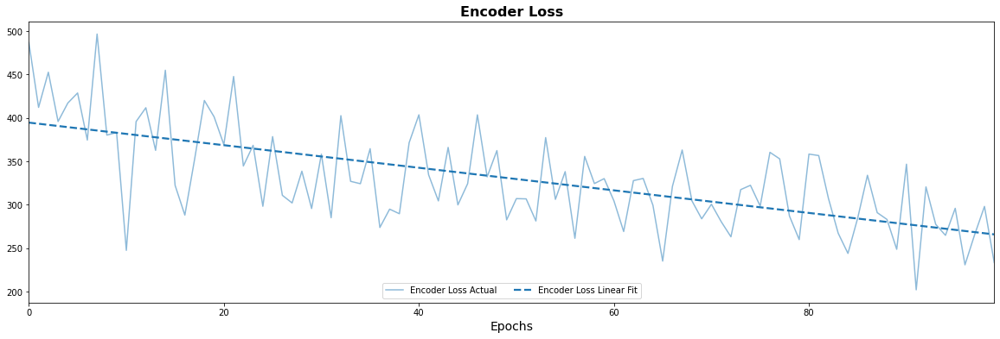

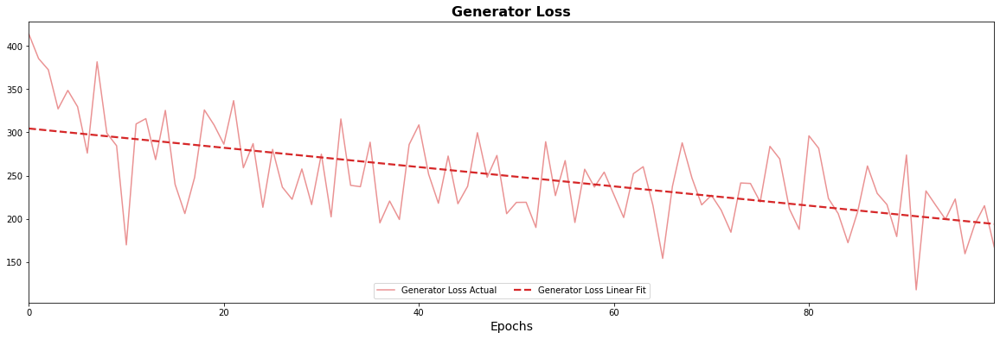

In [45]:
cp = sns.color_palette()

e = history.history['e_loss']
g = history.history['g_loss']
x = list(range(len(e)))

plt.figure(figsize= (20, 6))
plt.plot(x, e, label= 'Encoder Loss Actual', alpha= 0.5)
sns.regplot(x= x, y= e, label = 'Encoder Loss Linear Fit', scatter= False, ci= None, color= cp[0],
            line_kws = {'linestyle' : '--'})
plt.title('Encoder Loss', fontsize= 16, fontweight='bold')
plt.xlabel('Epochs', fontsize= 14)
plt.legend(loc = 'lower center', ncol= 2)
plt.show()

plt.figure(figsize= (20, 6))
plt.plot(x, g, label = 'Generator Loss Actual', color= cp[3], alpha= 0.5)
sns.regplot(x= x, y= g, label = 'Generator Loss Linear Fit', scatter= False, ci= None, color= cp[3],
            line_kws = {'linestyle' : '--'})
plt.title('Generator Loss', fontsize= 16, fontweight='bold')
plt.xlabel('Epochs', fontsize= 14)
plt.legend(loc = 'lower center', ncol= 2)
plt.show()

**Overall the decay in loss for both the encoder and generator is highly unstable, but trending downward.**

<a id="part5-9"></a>

## 5.9 Comparison with Baseline Model
[Return to contents](#contents)


In [52]:
latent_dim = 256

_input = Input(shape = (256, 384, 1), name= 'Input')

#Encoding layers

args_encoder = {'activation' : 'relu', 
                'padding' : 'same',
                'kernel_size' : (3, 3)}

conv2d_1 = Conv2D(filters= 12, **args_encoder, strides= (2,2), name= 'Conv2D_1')(_input)
conv2d_2 = Conv2D(filters= 24, **args_encoder, strides= (2,2), name= 'Conv2D_2')(conv2d_1)
conv2d_3 = Conv2D(filters= 36, **args_encoder, strides= (2,2), name= 'Conv2D_3')(conv2d_2)
conv2d_4 = Conv2D(filters= 48, **args_encoder, strides= (2,2), name= 'Conv2D_4')(conv2d_3)
conv2d_5 = Conv2D(filters= 64, **args_encoder, strides= (2,2), name= 'Conv2D_5')(conv2d_4)
conv2d_6 = Conv2D(filters= 96, **args_encoder, strides= (2,2), name= 'Conv2D_6')(conv2d_5)
flatten = Flatten(name= 'Flatten')(conv2d_6)

#Variational layers
z_mean = Dense(latent_dim, name= 'Mean')(flatten)
z_log_var = Dense(latent_dim, name= 'Log_Variance')(flatten)

#Embedding layers
embedding, drop1, drop2 = Sampling(name= 'Embedding')([z_mean, z_log_var])
dropout1 = Dropout(0.2, name= 'Dropout_1')(embedding)
end_embedding = Dense(2304, name= 'End_Embedding')(dropout1)
reshape = Reshape((4, 6, 96), name= 'Reshape')(end_embedding)

#Decoding layers
args_upsample = {'size' : (2, 2),
                 'interpolation' : 'nearest'}

args_decoder = {'activation' : 'relu', 
                'strides' : (1, 1), 
                'padding' : 'same',
                'kernel_size' : (3, 3)}

up_conv2d_1 = Conv2DTranspose(filters= 96, kernel_size= (2, 2), strides= 2, name= 'Conv2D_T1')(reshape)
up_conv2d_2 = Conv2DTranspose(filters= 64, kernel_size= (2, 2), strides= 2, name= 'Conv2D_T2')(up_conv2d_1)
up_conv2d_3 = Conv2DTranspose(filters= 48, kernel_size= (2, 2), strides= 2, name= 'Conv2D_T3')(up_conv2d_2)
up_conv2d_4 = Conv2DTranspose(filters= 24, kernel_size= (2, 2), strides= 2, name= 'Conv2D_T4')(up_conv2d_3)
up_conv2d_5 = Conv2DTranspose(filters= 12, kernel_size= (2, 2), strides= 2, name= 'Conv2D_T5')(up_conv2d_4)
up_conv2d_6 = Conv2DTranspose(filters= 6, kernel_size= (2, 2), strides= 2, name= 'Conv2D_T6')(up_conv2d_5)
output = Conv2DTranspose(filters= 1, kernel_size= (1, 1), name= 'Conv2D_T7')(up_conv2d_6)

VAE = tf.keras.Model(inputs= _input, outputs= output, name= 'VAE')

In [54]:
#Compiling the model
VAE.compile(optimizer= 'adam', loss= 'mean_squared_error')
history_VAE = VAE.fit(dio_tr, validation_data= dio_val, epochs= 100, verbose= True)

Epoch 1/100
50/50 [==============================] - 30s 558ms/step - loss: 0.2040 - val_loss: 0.0739
Epoch 2/100
50/50 [==============================] - 27s 541ms/step - loss: 0.0762 - val_loss: 0.0664
Epoch 3/100
50/50 [==============================] - 27s 540ms/step - loss: 0.0687 - val_loss: 0.0561
Epoch 4/100
50/50 [==============================] - 27s 543ms/step - loss: 0.0573 - val_loss: 0.0472
Epoch 5/100
50/50 [==============================] - 27s 543ms/step - loss: 0.0484 - val_loss: 0.0422
Epoch 6/100
50/50 [==============================] - 27s 540ms/step - loss: 0.0448 - val_loss: 0.0406
Epoch 7/100
50/50 [==============================] - 27s 547ms/step - loss: 0.0433 - val_loss: 0.0388
Epoch 8/100
50/50 [==============================] - 28s 554ms/step - loss: 0.0418 - val_loss: 0.0373
Epoch 9/100
50/50 [==============================] - 27s 546ms/step - loss: 0.0393 - val_loss: 0.0350
Epoch 10/100
50/50 [==============================] - 27s 544ms/step - loss: 0.038

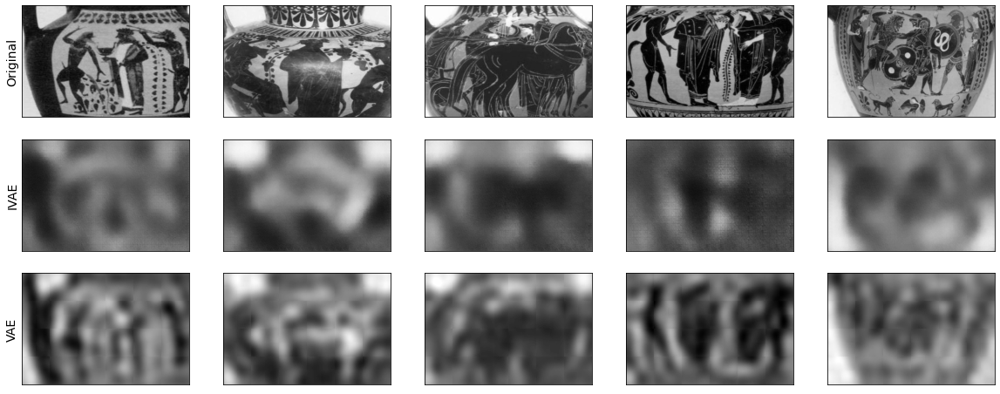

In [105]:
fig, axs = plt.subplots(3, 5)
fig.set_figwidth(20)
fig.set_figheight(8)
axl = axs.ravel()

for i in range(5):
    
    image = img_val[random_n[i]]
    
    axl[i].imshow(image, cmap= 'gray', vmin=0.0, vmax=1.0)
    
    image = np.expand_dims(image, axis= 0)
    z, z_mu, z_logvar = ivae_encoder.predict(image)
    pred = ivae_generator.predict(z)
    pred = pred[0,:,:,0]
    
    axl[i+5].imshow(pred, cmap= 'gray', vmin=0.0, vmax=1.0)
    
    pred = VAE.predict(image)
    pred = pred[0,:,:,0]
    
    axl[i+10].imshow(pred, cmap= 'gray', vmin=0.0, vmax=1.0)
    
for ax in axl:
    ax.set_xticks([])
    ax.set_yticks([])
    
axl[0].set_ylabel('Original', size= 14)
axl[5].set_ylabel('IVAE', size= 14)
axl[10].set_ylabel('VAE', size= 14);

In [95]:
z_preds, z_mu_preds, z_log_var_preds = ivae_encoder.predict(img_val)
ivae_preds = ivae_generator(z_preds)
vae_preds = VAE.predict(img_val)

ivae_rmse = np.mean(mean_squared_error(img_val, ivae_preds)) ** 0.5
ivae_rmse = str(np.round(ivae_rmse, 3))
vae_rmse = np.mean(mean_squared_error(img_val, vae_preds)) ** 0.5
vae_rmse = str(np.round(vae_rmse, 3))

print(f'IVAE RMSE = {ivae_rmse}, VAE RMSE = {vae_rmse}')

IVAE RMSE = 0.219, VAE RMSE = 0.172


**Unfortunately, the reconstruction of the images with the IVAE is worse than with the baseline VAE model** – the pictures are blurrier, and the RMSE is higher.

<a id="part5-10"></a>

## 5.10 Summary and Future Work
[Return to contents](#contents)


Our idea was that if we can reconstruct images at high-quality via an autencoder, we can apply a clustering algorithm to the latent space to detect emergent categories. Unfortunately, **since the reconstructed images are of poor quality, this apporach did not work.**

In the analysis conducted for Milestone 2 we found that **there wasn't meaningful clustering of points in the latent space created with the baseline VAE model.** **Since the reconstruction from the IVAE is worse,** both visually and by RMSE on the validation set, **we expect that the IVAE will not demonstrate emergent clustering in a meaningful way either.**

Moving forward, it will be interesting to see **if the IVAE could eventually outperform the VAE if trained for enough epochs.** Both were trained for 100 epochs, but maybe the VAE would hit a performance limit at some point where it could no longer minimize the loss. Also, time did not permit extensive **experimentation with the hyperparameters for the encoder and generator losses** for the IVAE which made a significant difference in outcomes in the IntroVAE paper.